# Imports

In [7]:
from __future__ import print_function
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
from  torch.utils.data import DataLoader 
from torch.autograd import Variable
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
from torchvision.datasets import ImageFolder
import sys
from torch.utils.data import Dataset
from skimage import io, transform
from matplotlib import pyplot as plt
from torch import nn
from torchvision.datasets import ImageFolder
from torchvision import datasets

from models import *
from data_loader import *


# Utility Functions

In [8]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)


def load_pretrained_models(modelG, modelD, output_dir):
    
    modelG.load_state_dict(torch.load(output_dir + 'bestG.pth'))
    modelD.load_state_dict(torch.load(output_dir + 'bestD.pth'))

    return modelG, modelD

def imshow(img):
    plt.imshow(img)
    plt.show()
    
class LandscapeDataset(Dataset):

    def __init__(self, root_dir, transforms=None):
        
        """
        Args:
            root_dir (string): Directory with all the images.
            file_list (list): List of strings of filename in batch
            img_list: List of images
        """

        self.root_dir = root_dir
        self.transforms = transforms
        

        # Go to root directory and create list of all filenames
        self.file_list = [f for f in os.listdir(root_dir) if os.path.isfile(os.path.join(root_dir, f))]


    def __len__(self):
        return int(len(self.file_list))

    
    def __getitem__(self, idx):
  
        filename = self.file_list[idx]
        img = io.imread(self.root_dir+filename)

        if self.transforms is not None:
            img = self.transforms(img)


        return img

    
def imshow_batch(batch):
    
    
    plt.figure()
    for batch_num in range(5):
        plt.subplot(151 + batch_num)
        to_plot = np.moveaxis(batch[batch_num, :, :, :], 0, 2)
        plt.imshow(to_plot)
        plt.axis('off')
    

# Prep GPU

In [9]:
GPU = torch.cuda.is_available()
print("GPU is {}enabled \n".format(['not ', ''][GPU]))

GPU is enabled 



# Initialize Network

In [10]:
print('Initializing the Network...\n')

# Specify Models
z_dim = 28
g_filter_size = 64
out_channels = 1

netG = Generator_128(100, 32, 3)
netD = Patch_Discriminator_128(input_channels=3)

warm_start = False
output_dir = './gan_output/'

if warm_start:
    netG, netD = load_pretrained_models(netG, netD, output_dir)


# netG = netG.apply(weights_init)
# netD = netD.apply(weights_init)

if GPU: 
    netG = netG.cuda()
    netD = netD.cuda()

criterion = nn.BCELoss() # "Binary Cross Entropy", not "Before Common Era"

# Specify Optimizer ############################################ LEARNING RATE HERE!

lr_G = 0.00005
lr_D = 0.00005

beta = 0.5 # momentum?

optimizerD = optim.Adam(netD.parameters(), lr=lr_D, betas=(beta, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr_G, betas=(beta, 0.999))

print('Done!')


Initializing the Network...

3
Done!


# Prep Data

In [11]:
print('Prepping Data...')

batch_size = 64 ############################################ BATCH SIZE HERE!

num_epochs = 500

root_dir = './monet2photo/trainB/'

down_sample = 128

data_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.RandomResizedCrop(down_sample),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(mean=[.5, .5, .5],
                             std=[.5, .5, .5])
    ])

#         transforms.Normalize(mean=[0.485, 0.456, 0.406],
#                              std=[0.229, 0.224, 0.225])


dataset = LandscapeDataset(root_dir, transforms=data_transform)
train_loader = DataLoader(dataset,
                          batch_size=batch_size,
                          shuffle=True,
                          num_workers=4
                         )





print('Done!')


Prepping Data...
Done!


# Train

[0/500][0/99] Loss_D: 0.6175 Loss_G: 1.0180 D(x): 0.9161 D(G(z)): 0.4091 / 0.3614


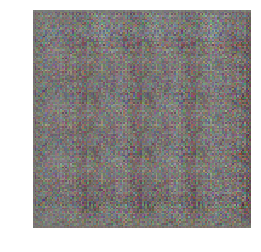

[0/500][10/99] Loss_D: 0.5226 Loss_G: 1.1319 D(x): 0.9374 D(G(z)): 0.3667 / 0.3225


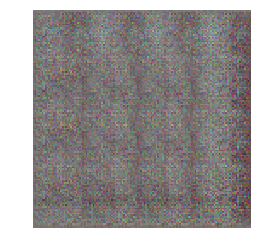

[0/500][20/99] Loss_D: 0.4755 Loss_G: 1.2126 D(x): 0.9442 D(G(z)): 0.3408 / 0.2974


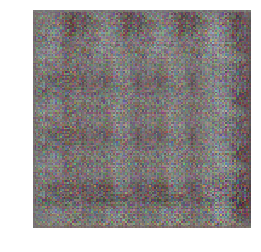

[0/500][30/99] Loss_D: 0.4481 Loss_G: 1.2977 D(x): 0.9374 D(G(z)): 0.3169 / 0.2732


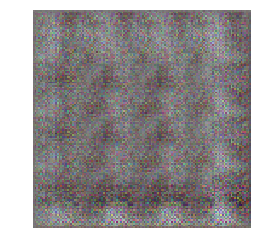

[0/500][40/99] Loss_D: 0.4388 Loss_G: 1.3389 D(x): 0.9317 D(G(z)): 0.3056 / 0.2623


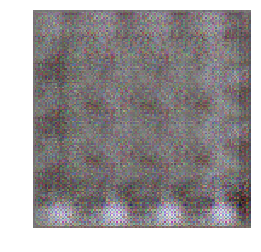

[0/500][50/99] Loss_D: 0.3743 Loss_G: 1.4753 D(x): 0.9505 D(G(z)): 0.2754 / 0.2288


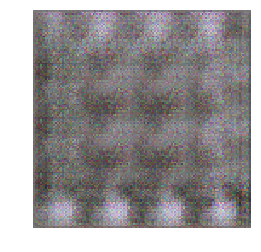

[0/500][60/99] Loss_D: 0.5714 Loss_G: 1.2768 D(x): 0.9156 D(G(z)): 0.3799 / 0.2790


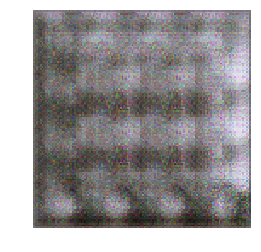

[0/500][70/99] Loss_D: 1.2517 Loss_G: 2.0155 D(x): 0.4389 D(G(z)): 0.1402 / 0.1345


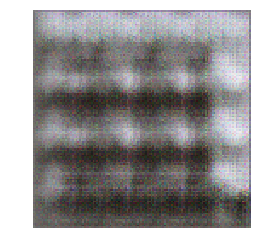

[0/500][80/99] Loss_D: 0.9584 Loss_G: 1.0707 D(x): 0.6323 D(G(z)): 0.3685 / 0.3428


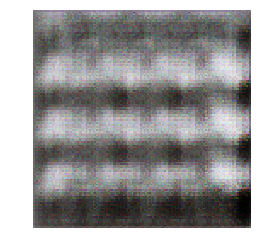

[0/500][90/99] Loss_D: 0.6389 Loss_G: 1.2725 D(x): 0.7854 D(G(z)): 0.3157 / 0.2801


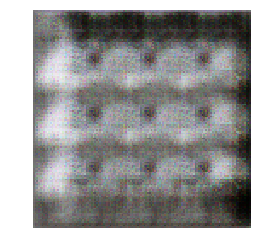

[1/500][0/99] Loss_D: 0.4433 Loss_G: 1.5991 D(x): 0.8568 D(G(z)): 0.2393 / 0.2022


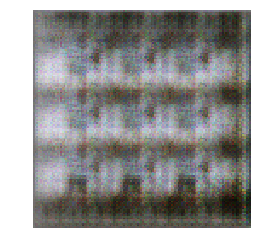

[1/500][10/99] Loss_D: 0.4766 Loss_G: 1.3370 D(x): 0.9029 D(G(z)): 0.3076 / 0.2627


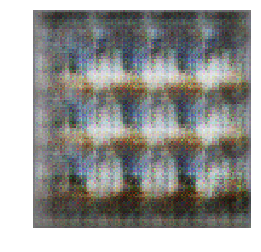

[1/500][20/99] Loss_D: 0.4107 Loss_G: 1.4381 D(x): 0.9256 D(G(z)): 0.2792 / 0.2374


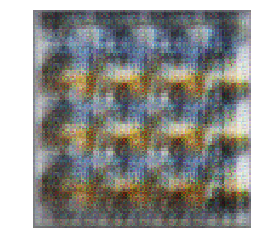

[1/500][30/99] Loss_D: 0.3626 Loss_G: 1.4397 D(x): 0.9642 D(G(z)): 0.2778 / 0.2370


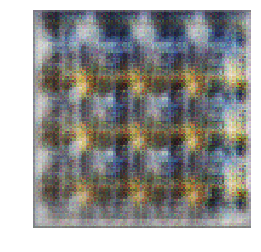

[1/500][40/99] Loss_D: 0.3282 Loss_G: 1.5345 D(x): 0.9618 D(G(z)): 0.2503 / 0.2157


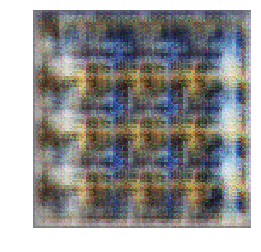

[1/500][50/99] Loss_D: 0.3108 Loss_G: 1.6350 D(x): 0.9490 D(G(z)): 0.2269 / 0.1950


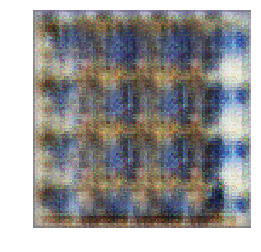

[1/500][60/99] Loss_D: 0.3931 Loss_G: 1.5675 D(x): 0.9190 D(G(z)): 0.2625 / 0.2088


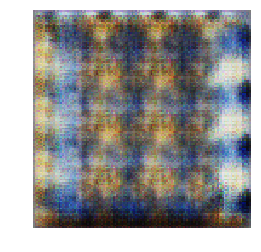

[1/500][70/99] Loss_D: 0.4650 Loss_G: 1.4575 D(x): 0.8573 D(G(z)): 0.2627 / 0.2328


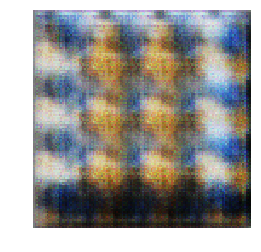

[1/500][80/99] Loss_D: 0.4240 Loss_G: 1.4848 D(x): 0.8781 D(G(z)): 0.2464 / 0.2267


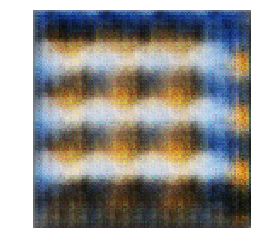

[1/500][90/99] Loss_D: 0.6859 Loss_G: 2.0048 D(x): 0.6678 D(G(z)): 0.0997 / 0.1365


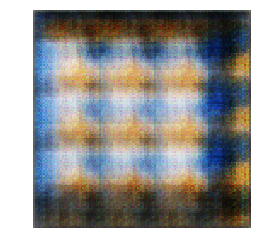

[2/500][0/99] Loss_D: 0.5065 Loss_G: 1.6171 D(x): 0.8019 D(G(z)): 0.2205 / 0.2013


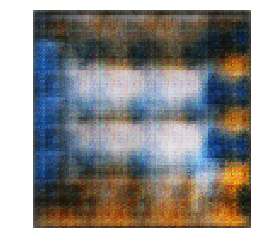

[2/500][10/99] Loss_D: 0.6256 Loss_G: 1.6419 D(x): 0.7375 D(G(z)): 0.2518 / 0.1957


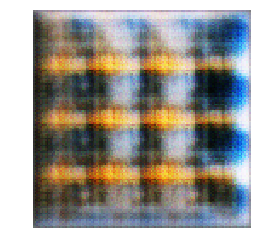

[2/500][20/99] Loss_D: 1.6966 Loss_G: 2.1442 D(x): 0.3363 D(G(z)): 0.1361 / 0.1347


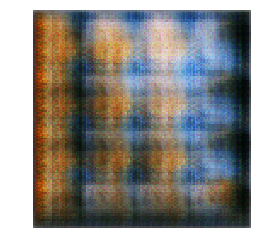

[2/500][30/99] Loss_D: 0.9735 Loss_G: 1.1939 D(x): 0.6602 D(G(z)): 0.3993 / 0.3045


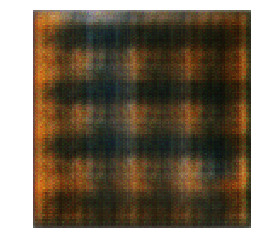

[2/500][40/99] Loss_D: 1.0137 Loss_G: 1.3086 D(x): 0.6119 D(G(z)): 0.3895 / 0.2752


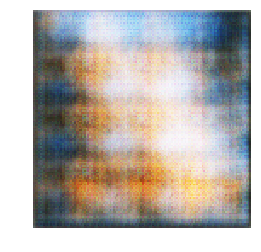

[2/500][50/99] Loss_D: 0.9294 Loss_G: 1.3397 D(x): 0.6899 D(G(z)): 0.3998 / 0.2669


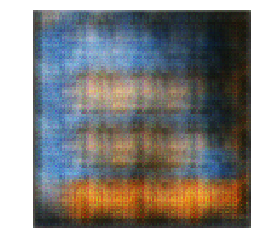

[2/500][60/99] Loss_D: 0.8767 Loss_G: 1.4088 D(x): 0.7203 D(G(z)): 0.4037 / 0.2468


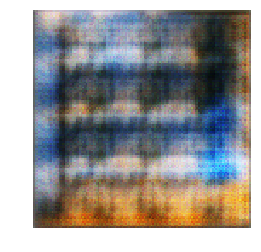

[2/500][70/99] Loss_D: 0.9083 Loss_G: 1.1918 D(x): 0.7095 D(G(z)): 0.3932 / 0.3133


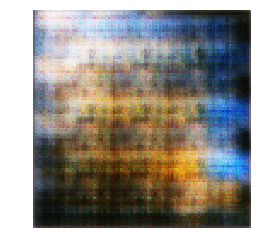

[2/500][80/99] Loss_D: 0.9981 Loss_G: 1.1803 D(x): 0.5103 D(G(z)): 0.2504 / 0.3122


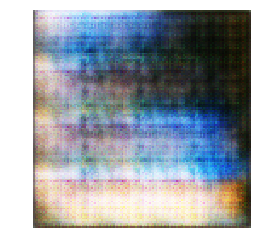

[2/500][90/99] Loss_D: 1.3640 Loss_G: 1.6520 D(x): 0.6354 D(G(z)): 0.4813 / 0.2873


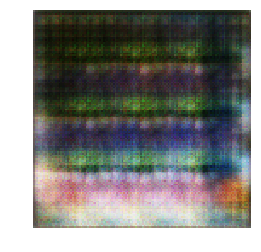

[3/500][0/99] Loss_D: 0.8922 Loss_G: 1.2330 D(x): 0.6929 D(G(z)): 0.3983 / 0.2935


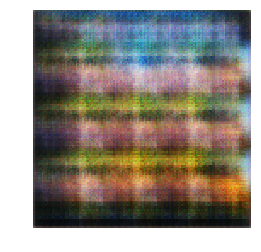

[3/500][10/99] Loss_D: 1.0815 Loss_G: 1.0391 D(x): 0.6323 D(G(z)): 0.4388 / 0.3594


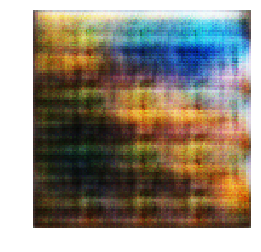

[3/500][20/99] Loss_D: 1.3848 Loss_G: 0.9709 D(x): 0.4796 D(G(z)): 0.4421 / 0.3951


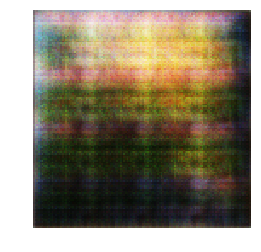

[3/500][30/99] Loss_D: 1.3450 Loss_G: 1.0047 D(x): 0.5593 D(G(z)): 0.4716 / 0.4119


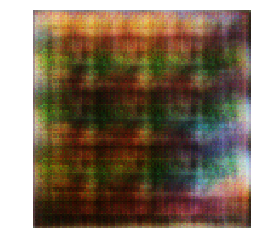

[3/500][40/99] Loss_D: 1.2370 Loss_G: 1.1298 D(x): 0.5049 D(G(z)): 0.3957 / 0.3258


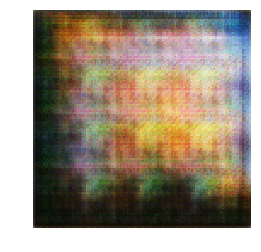

[3/500][50/99] Loss_D: 1.3887 Loss_G: 0.8640 D(x): 0.5487 D(G(z)): 0.5136 / 0.4245


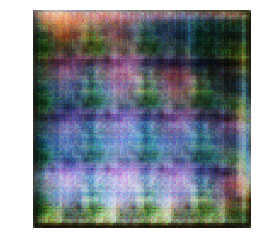

[3/500][60/99] Loss_D: 1.3374 Loss_G: 1.1308 D(x): 0.4631 D(G(z)): 0.4050 / 0.3310


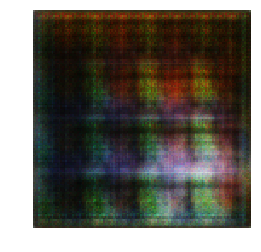

[3/500][70/99] Loss_D: 1.1615 Loss_G: 0.9787 D(x): 0.5832 D(G(z)): 0.4465 / 0.3778


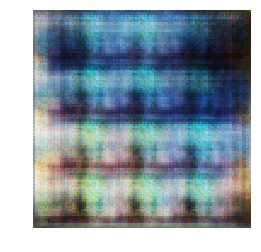

[3/500][80/99] Loss_D: 1.2397 Loss_G: 0.8853 D(x): 0.5415 D(G(z)): 0.4473 / 0.4168


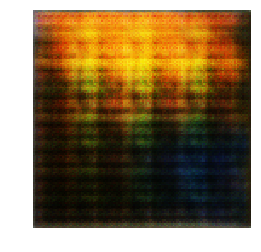

[3/500][90/99] Loss_D: 1.3063 Loss_G: 0.8291 D(x): 0.5749 D(G(z)): 0.5003 / 0.4398


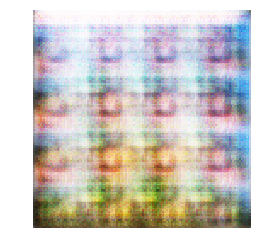

[4/500][0/99] Loss_D: 1.3996 Loss_G: 0.9091 D(x): 0.5161 D(G(z)): 0.4874 / 0.4111


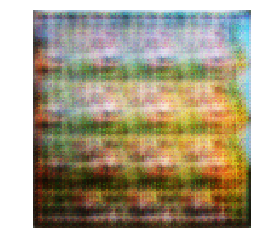

[4/500][10/99] Loss_D: 1.3643 Loss_G: 0.9425 D(x): 0.5222 D(G(z)): 0.4877 / 0.3958


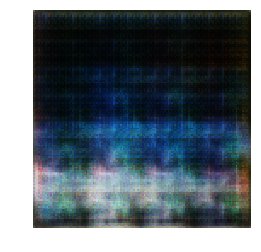

[4/500][20/99] Loss_D: 1.3328 Loss_G: 0.9112 D(x): 0.5115 D(G(z)): 0.4670 / 0.4066


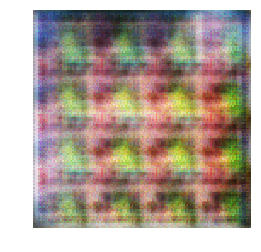

[4/500][30/99] Loss_D: 1.2794 Loss_G: 0.8979 D(x): 0.5601 D(G(z)): 0.4847 / 0.4150


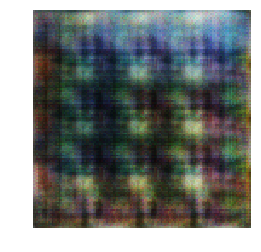

[4/500][40/99] Loss_D: 1.3853 Loss_G: 0.9053 D(x): 0.5350 D(G(z)): 0.5057 / 0.4217


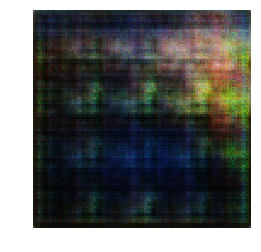

[4/500][50/99] Loss_D: 1.1908 Loss_G: 0.9348 D(x): 0.5802 D(G(z)): 0.4654 / 0.3992


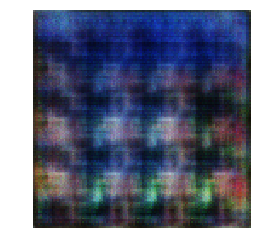

[4/500][60/99] Loss_D: 1.4404 Loss_G: 1.0370 D(x): 0.4403 D(G(z)): 0.4206 / 0.3620


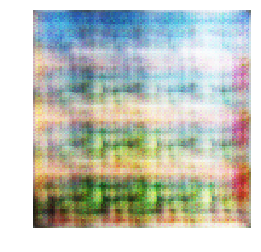

[4/500][70/99] Loss_D: 1.3807 Loss_G: 0.8840 D(x): 0.4761 D(G(z)): 0.4616 / 0.4162


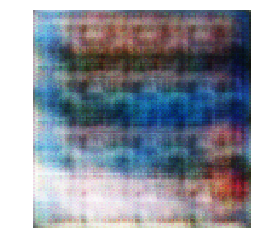

[4/500][80/99] Loss_D: 1.3463 Loss_G: 0.8368 D(x): 0.5299 D(G(z)): 0.4874 / 0.4381


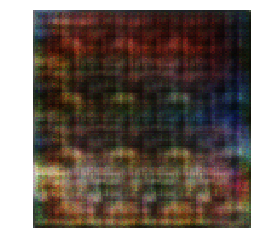

[4/500][90/99] Loss_D: 1.2700 Loss_G: 0.8214 D(x): 0.5547 D(G(z)): 0.4892 / 0.4407


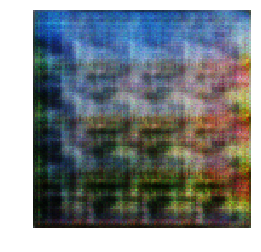

[5/500][0/99] Loss_D: 1.2704 Loss_G: 0.8919 D(x): 0.5453 D(G(z)): 0.4747 / 0.4131


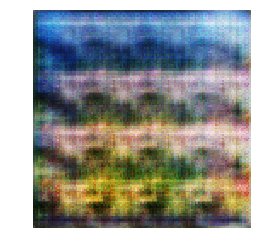

[5/500][10/99] Loss_D: 1.2979 Loss_G: 0.9963 D(x): 0.4452 D(G(z)): 0.3494 / 0.4122


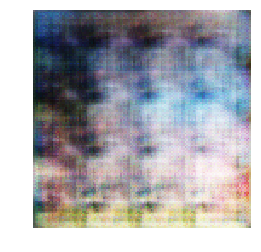

[5/500][20/99] Loss_D: 1.1857 Loss_G: 0.8852 D(x): 0.5889 D(G(z)): 0.4588 / 0.4176


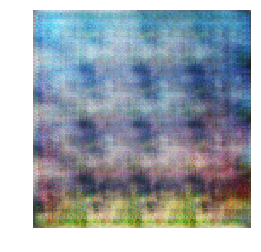

[5/500][30/99] Loss_D: 1.3813 Loss_G: 0.9446 D(x): 0.4664 D(G(z)): 0.4218 / 0.3934


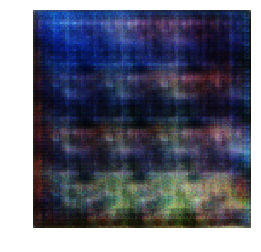

[5/500][40/99] Loss_D: 1.2404 Loss_G: 1.0031 D(x): 0.5554 D(G(z)): 0.4386 / 0.3737


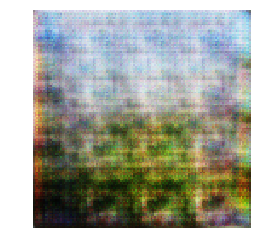

[5/500][50/99] Loss_D: 1.2830 Loss_G: 0.9655 D(x): 0.5250 D(G(z)): 0.4464 / 0.3845


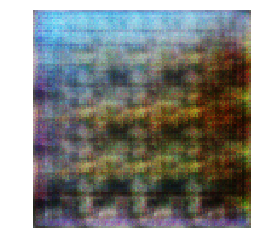

[5/500][60/99] Loss_D: 1.1743 Loss_G: 0.9264 D(x): 0.5995 D(G(z)): 0.4647 / 0.4001


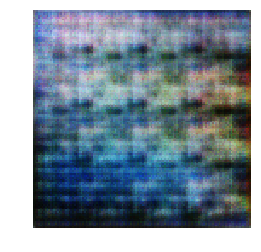

[5/500][70/99] Loss_D: 1.2887 Loss_G: 0.8802 D(x): 0.5579 D(G(z)): 0.4802 / 0.4673


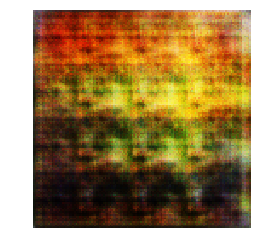

[5/500][80/99] Loss_D: 1.3582 Loss_G: 0.8189 D(x): 0.5640 D(G(z)): 0.5240 / 0.4437


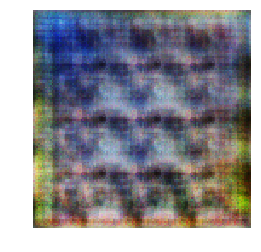

[5/500][90/99] Loss_D: 1.2290 Loss_G: 0.9212 D(x): 0.5692 D(G(z)): 0.4740 / 0.4005


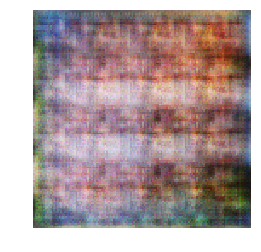

[6/500][0/99] Loss_D: 1.3698 Loss_G: 1.0041 D(x): 0.4891 D(G(z)): 0.4543 / 0.3744


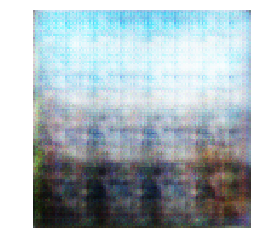

[6/500][10/99] Loss_D: 1.2038 Loss_G: 0.8748 D(x): 0.5654 D(G(z)): 0.4540 / 0.4233


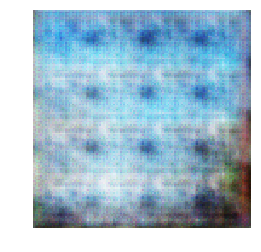

[6/500][20/99] Loss_D: 1.2037 Loss_G: 0.7707 D(x): 0.5628 D(G(z)): 0.4561 / 0.4727


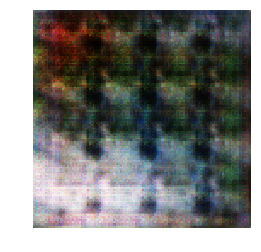

[6/500][30/99] Loss_D: 1.2043 Loss_G: 0.9076 D(x): 0.5416 D(G(z)): 0.4324 / 0.4052


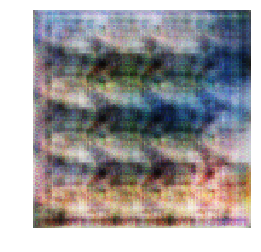

[6/500][40/99] Loss_D: 1.5942 Loss_G: 1.1414 D(x): 0.3614 D(G(z)): 0.3546 / 0.3640


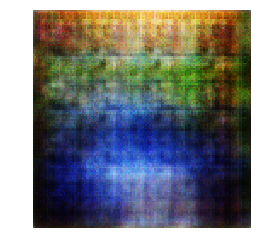

[6/500][50/99] Loss_D: 1.2315 Loss_G: 0.8620 D(x): 0.6105 D(G(z)): 0.5047 / 0.4273


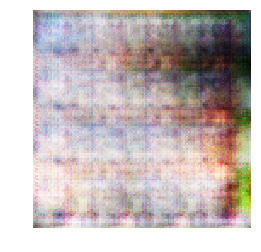

[6/500][60/99] Loss_D: 1.3926 Loss_G: 0.8443 D(x): 0.5022 D(G(z)): 0.4877 / 0.4329


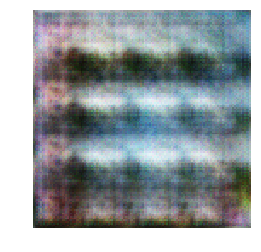

[6/500][70/99] Loss_D: 1.5763 Loss_G: 1.1074 D(x): 0.5319 D(G(z)): 0.5144 / 0.3487


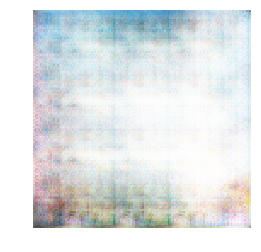

[6/500][80/99] Loss_D: 1.3290 Loss_G: 0.8294 D(x): 0.5237 D(G(z)): 0.4670 / 0.4388


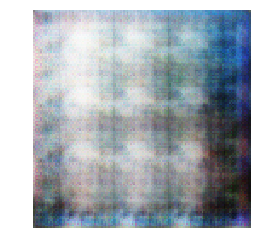

[6/500][90/99] Loss_D: 1.3271 Loss_G: 0.7655 D(x): 0.5320 D(G(z)): 0.4858 / 0.4666


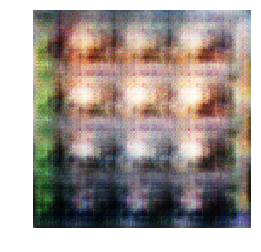

[7/500][0/99] Loss_D: 1.2554 Loss_G: 0.7981 D(x): 0.5710 D(G(z)): 0.4840 / 0.4526


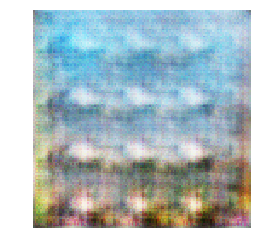

[7/500][10/99] Loss_D: 1.3282 Loss_G: 0.7897 D(x): 0.5010 D(G(z)): 0.4579 / 0.4552


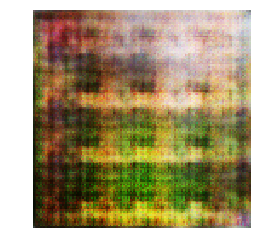

[7/500][20/99] Loss_D: 1.3528 Loss_G: 0.7701 D(x): 0.5572 D(G(z)): 0.5096 / 0.4797


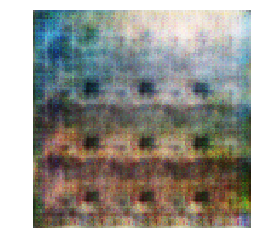

[7/500][30/99] Loss_D: 1.2578 Loss_G: 0.7722 D(x): 0.5717 D(G(z)): 0.4810 / 0.4639


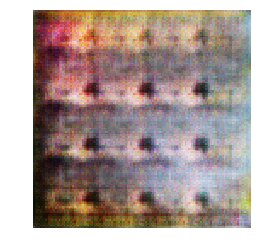

[7/500][40/99] Loss_D: 1.3280 Loss_G: 0.7869 D(x): 0.4966 D(G(z)): 0.4496 / 0.4601


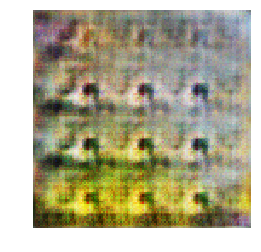

[7/500][50/99] Loss_D: 1.3424 Loss_G: 0.8534 D(x): 0.4701 D(G(z)): 0.4226 / 0.4321


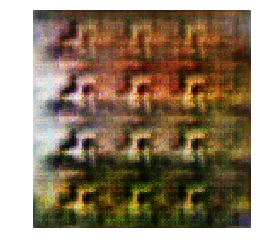

[7/500][60/99] Loss_D: 1.2512 Loss_G: 0.7136 D(x): 0.5540 D(G(z)): 0.4739 / 0.4934


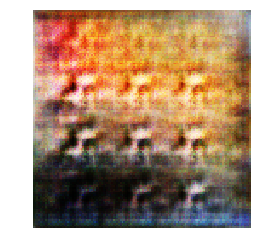

[7/500][70/99] Loss_D: 1.3454 Loss_G: 0.8650 D(x): 0.4454 D(G(z)): 0.4088 / 0.4224


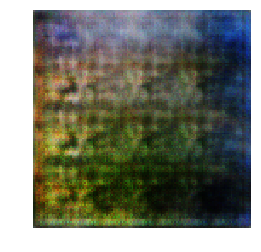

[7/500][80/99] Loss_D: 1.2638 Loss_G: 0.7478 D(x): 0.5677 D(G(z)): 0.4899 / 0.4765


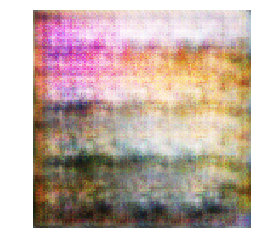

[7/500][90/99] Loss_D: 1.2997 Loss_G: 0.9085 D(x): 0.4958 D(G(z)): 0.4229 / 0.4084


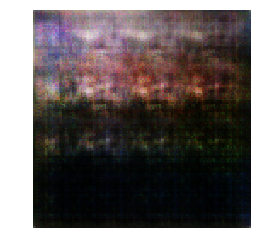

[8/500][0/99] Loss_D: 1.4602 Loss_G: 0.8200 D(x): 0.4941 D(G(z)): 0.5084 / 0.4430


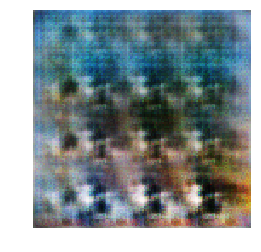

[8/500][10/99] Loss_D: 1.4283 Loss_G: 0.8998 D(x): 0.4605 D(G(z)): 0.4573 / 0.4086


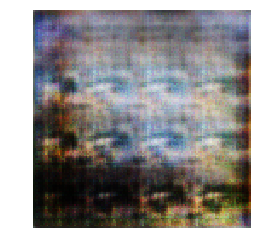

[8/500][20/99] Loss_D: 1.2681 Loss_G: 0.7434 D(x): 0.5314 D(G(z)): 0.4585 / 0.4806


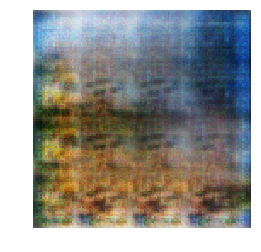

[8/500][30/99] Loss_D: 1.2574 Loss_G: 0.8030 D(x): 0.5606 D(G(z)): 0.4720 / 0.4502


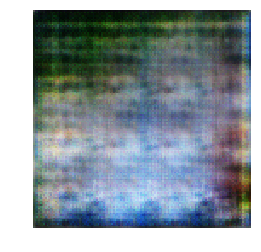

[8/500][40/99] Loss_D: 1.2993 Loss_G: 0.7959 D(x): 0.5354 D(G(z)): 0.4729 / 0.4540


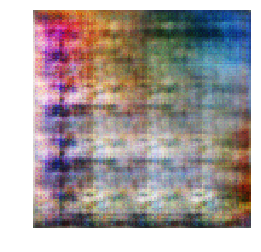

[8/500][50/99] Loss_D: 1.3873 Loss_G: 0.9160 D(x): 0.4481 D(G(z)): 0.4112 / 0.4033


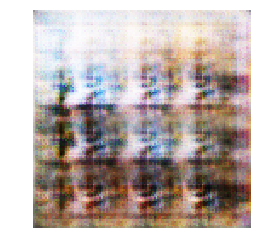

[8/500][60/99] Loss_D: 1.3390 Loss_G: 0.8168 D(x): 0.4986 D(G(z)): 0.4587 / 0.4446


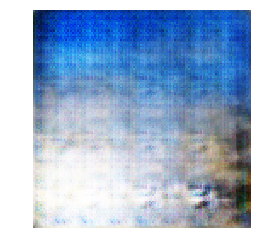

[8/500][70/99] Loss_D: 1.3036 Loss_G: 0.7795 D(x): 0.5180 D(G(z)): 0.4641 / 0.4605


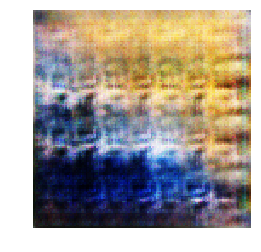

[8/500][80/99] Loss_D: 1.3767 Loss_G: 0.7971 D(x): 0.5265 D(G(z)): 0.4948 / 0.4550


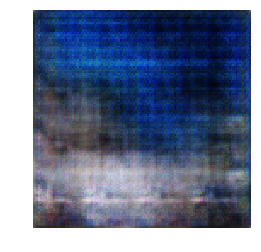

[8/500][90/99] Loss_D: 1.3964 Loss_G: 0.7473 D(x): 0.4912 D(G(z)): 0.4884 / 0.4751


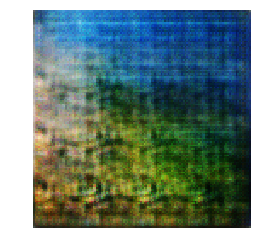

[9/500][0/99] Loss_D: 1.3554 Loss_G: 0.8185 D(x): 0.5002 D(G(z)): 0.4694 / 0.4424


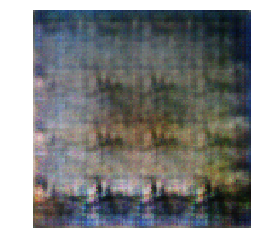

[9/500][10/99] Loss_D: 1.3500 Loss_G: 0.7755 D(x): 0.4764 D(G(z)): 0.4475 / 0.4656


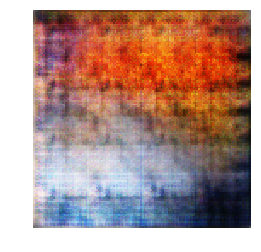

[9/500][20/99] Loss_D: 1.3563 Loss_G: 0.7123 D(x): 0.5292 D(G(z)): 0.4965 / 0.4961


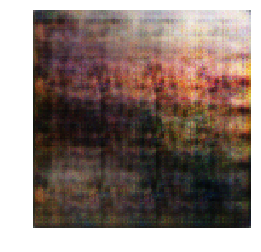

[9/500][30/99] Loss_D: 1.3702 Loss_G: 0.7450 D(x): 0.5383 D(G(z)): 0.5139 / 0.4772


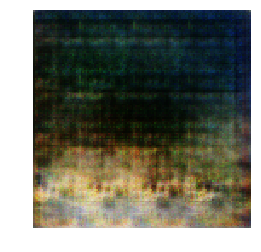

[9/500][40/99] Loss_D: 1.4061 Loss_G: 0.9238 D(x): 0.4468 D(G(z)): 0.4202 / 0.4009


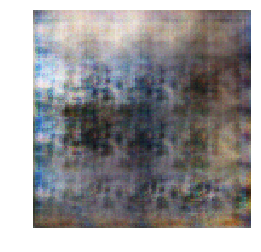

[9/500][50/99] Loss_D: 1.4054 Loss_G: 0.7881 D(x): 0.5353 D(G(z)): 0.5193 / 0.4609


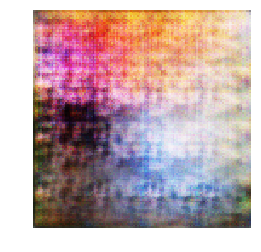

[9/500][60/99] Loss_D: 1.3480 Loss_G: 0.7576 D(x): 0.4919 D(G(z)): 0.4624 / 0.4708


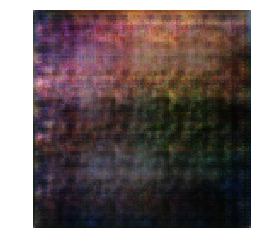

[9/500][70/99] Loss_D: 1.3652 Loss_G: 0.6606 D(x): 0.5065 D(G(z)): 0.4867 / 0.5241


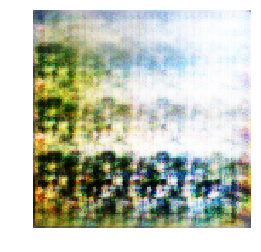

[9/500][80/99] Loss_D: 1.3944 Loss_G: 0.7791 D(x): 0.4974 D(G(z)): 0.4915 / 0.4621


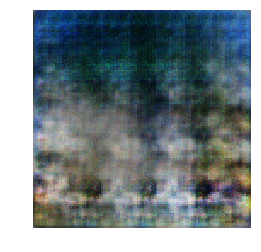

[9/500][90/99] Loss_D: 1.3901 Loss_G: 0.7810 D(x): 0.4714 D(G(z)): 0.4657 / 0.4604


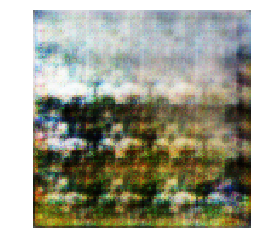

[10/500][0/99] Loss_D: 1.3653 Loss_G: 0.7658 D(x): 0.4822 D(G(z)): 0.4625 / 0.4685


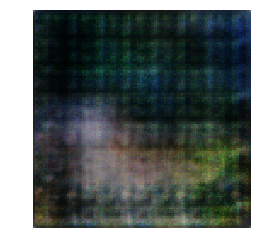

[10/500][10/99] Loss_D: 1.3419 Loss_G: 0.7560 D(x): 0.5245 D(G(z)): 0.4895 / 0.4732


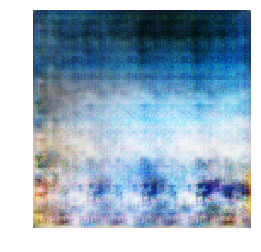

[10/500][20/99] Loss_D: 1.3615 Loss_G: 0.7281 D(x): 0.5030 D(G(z)): 0.4832 / 0.4850


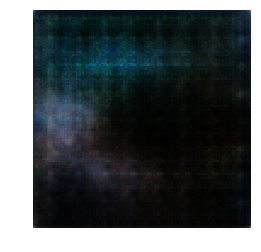

[10/500][30/99] Loss_D: 1.3779 Loss_G: 0.8250 D(x): 0.5004 D(G(z)): 0.4821 / 0.4396


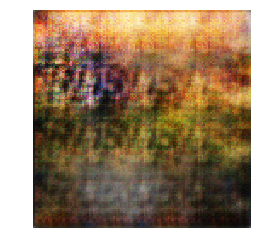

[10/500][40/99] Loss_D: 1.3448 Loss_G: 0.7226 D(x): 0.5025 D(G(z)): 0.4679 / 0.4901


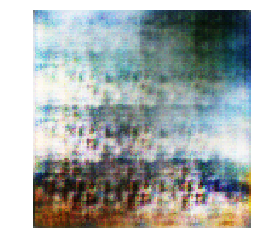

[10/500][50/99] Loss_D: 1.3829 Loss_G: 0.8427 D(x): 0.5037 D(G(z)): 0.4672 / 0.4377


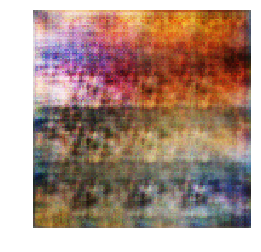

[10/500][60/99] Loss_D: 1.4120 Loss_G: 0.8045 D(x): 0.4693 D(G(z)): 0.4710 / 0.4486


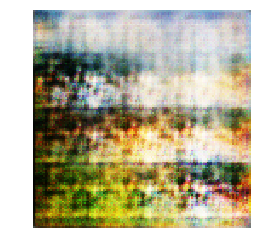

[10/500][70/99] Loss_D: 1.4080 Loss_G: 0.7933 D(x): 0.4587 D(G(z)): 0.4578 / 0.4532


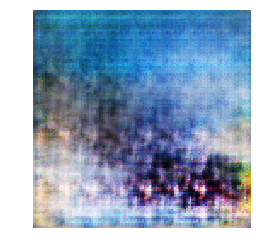

[10/500][80/99] Loss_D: 1.3237 Loss_G: 0.7296 D(x): 0.5523 D(G(z)): 0.5118 / 0.4837


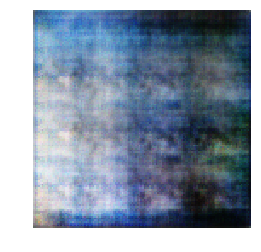

[10/500][90/99] Loss_D: 1.3749 Loss_G: 0.7740 D(x): 0.4840 D(G(z)): 0.4677 / 0.4633


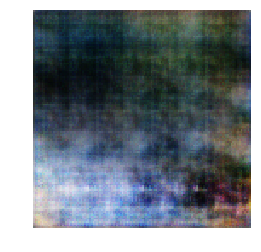

[11/500][0/99] Loss_D: 1.3658 Loss_G: 0.7517 D(x): 0.5106 D(G(z)): 0.4940 / 0.4735


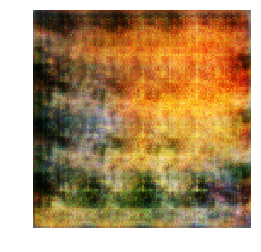

[11/500][10/99] Loss_D: 1.3668 Loss_G: 0.7725 D(x): 0.5094 D(G(z)): 0.4926 / 0.4634


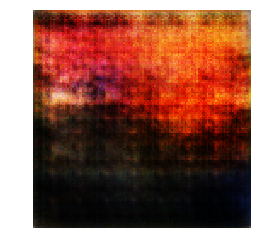

[11/500][20/99] Loss_D: 1.3733 Loss_G: 0.7793 D(x): 0.5139 D(G(z)): 0.4964 / 0.4610


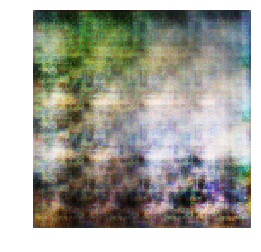

[11/500][30/99] Loss_D: 1.4017 Loss_G: 0.7395 D(x): 0.4809 D(G(z)): 0.4804 / 0.4802


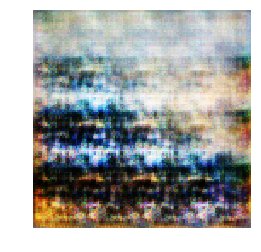

[11/500][40/99] Loss_D: 1.4057 Loss_G: 0.7999 D(x): 0.4753 D(G(z)): 0.4772 / 0.4504


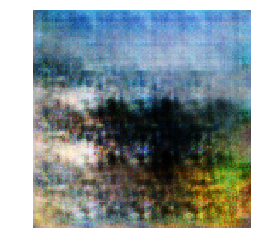

[11/500][50/99] Loss_D: 1.3766 Loss_G: 0.7294 D(x): 0.5058 D(G(z)): 0.4920 / 0.4849


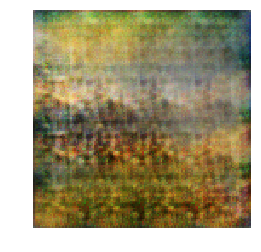

[11/500][60/99] Loss_D: 1.4002 Loss_G: 0.7724 D(x): 0.4602 D(G(z)): 0.4602 / 0.4641


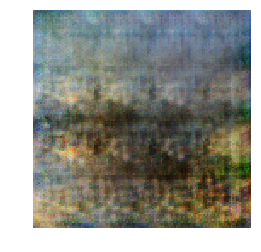

[11/500][70/99] Loss_D: 1.4266 Loss_G: 0.7797 D(x): 0.4899 D(G(z)): 0.4995 / 0.4596


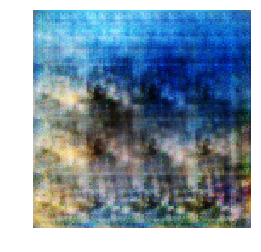

[11/500][80/99] Loss_D: 1.3729 Loss_G: 0.7404 D(x): 0.4915 D(G(z)): 0.4800 / 0.4783


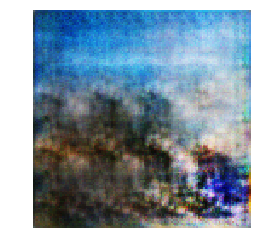

[11/500][90/99] Loss_D: 1.3753 Loss_G: 0.7287 D(x): 0.5454 D(G(z)): 0.5205 / 0.4847


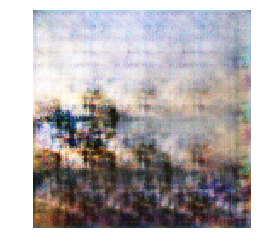

[12/500][0/99] Loss_D: 1.4175 Loss_G: 0.7730 D(x): 0.5134 D(G(z)): 0.5182 / 0.4648


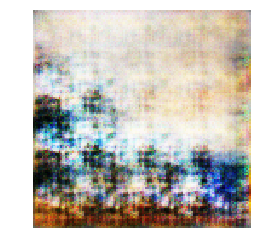

[12/500][10/99] Loss_D: 1.3730 Loss_G: 0.7458 D(x): 0.4907 D(G(z)): 0.4723 / 0.4790


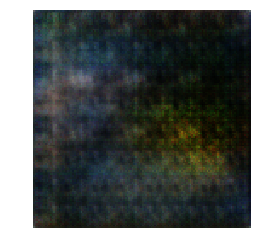

[12/500][20/99] Loss_D: 1.4196 Loss_G: 0.7927 D(x): 0.4841 D(G(z)): 0.4930 / 0.4538


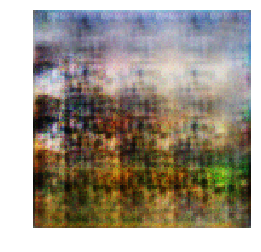

[12/500][30/99] Loss_D: 1.3621 Loss_G: 0.7728 D(x): 0.4825 D(G(z)): 0.4627 / 0.4638


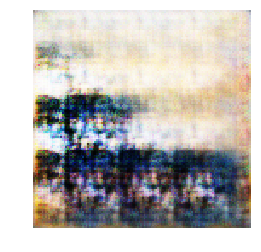

[12/500][40/99] Loss_D: 1.3614 Loss_G: 0.7760 D(x): 0.4709 D(G(z)): 0.4510 / 0.4630


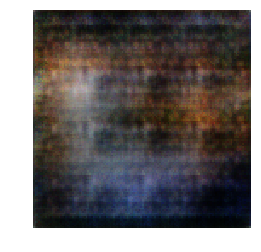

[12/500][50/99] Loss_D: 1.3688 Loss_G: 0.7582 D(x): 0.4680 D(G(z)): 0.4506 / 0.4710


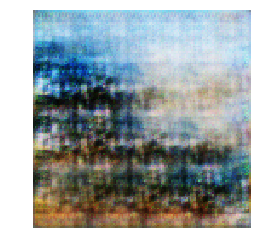

[12/500][60/99] Loss_D: 1.4282 Loss_G: 0.7577 D(x): 0.4811 D(G(z)): 0.4934 / 0.4703


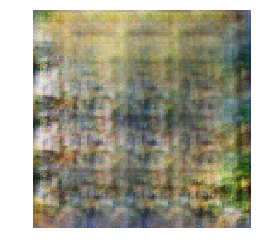

[12/500][70/99] Loss_D: 1.4385 Loss_G: 0.8649 D(x): 0.4396 D(G(z)): 0.4322 / 0.4260


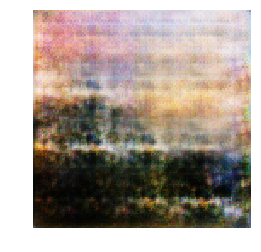

[12/500][80/99] Loss_D: 1.4099 Loss_G: 0.7857 D(x): 0.4929 D(G(z)): 0.4946 / 0.4579


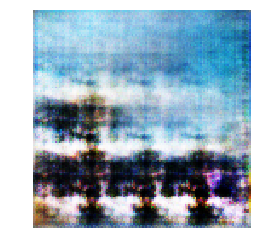

[12/500][90/99] Loss_D: 1.4002 Loss_G: 0.7528 D(x): 0.4908 D(G(z)): 0.4872 / 0.4725


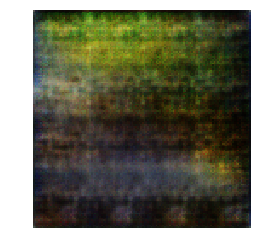

[13/500][0/99] Loss_D: 1.3544 Loss_G: 0.7383 D(x): 0.4903 D(G(z)): 0.4695 / 0.4809


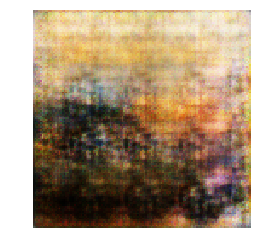

[13/500][10/99] Loss_D: 1.4249 Loss_G: 0.8033 D(x): 0.4533 D(G(z)): 0.4650 / 0.4500


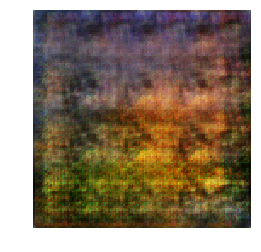

[13/500][20/99] Loss_D: 1.3941 Loss_G: 0.7964 D(x): 0.4985 D(G(z)): 0.4925 / 0.4530


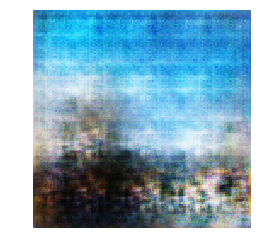

[13/500][30/99] Loss_D: 1.4197 Loss_G: 0.8147 D(x): 0.4423 D(G(z)): 0.4431 / 0.4449


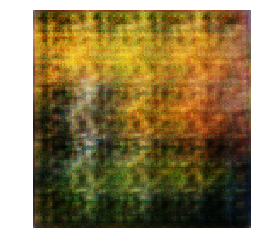

[13/500][40/99] Loss_D: 1.4089 Loss_G: 0.7161 D(x): 0.5118 D(G(z)): 0.5151 / 0.4900


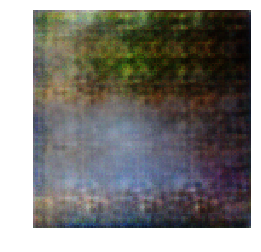

[13/500][50/99] Loss_D: 1.4220 Loss_G: 0.8093 D(x): 0.4475 D(G(z)): 0.4558 / 0.4468


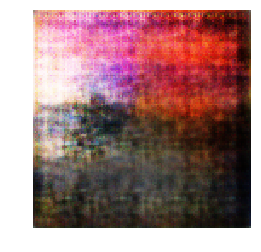

[13/500][60/99] Loss_D: 1.4223 Loss_G: 0.7477 D(x): 0.4895 D(G(z)): 0.5000 / 0.4766


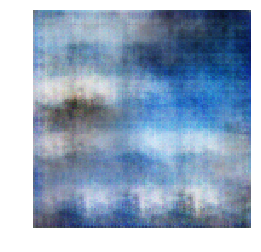

[13/500][70/99] Loss_D: 1.3835 Loss_G: 0.7112 D(x): 0.5125 D(G(z)): 0.5011 / 0.4931


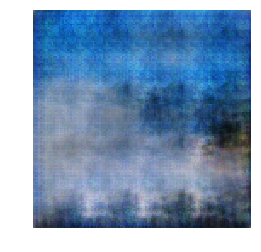

[13/500][80/99] Loss_D: 1.3495 Loss_G: 0.7329 D(x): 0.4821 D(G(z)): 0.4588 / 0.4856


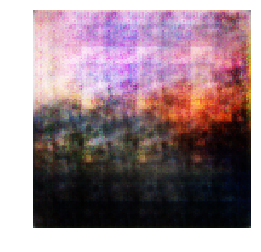

[13/500][90/99] Loss_D: 1.3885 Loss_G: 0.7348 D(x): 0.4860 D(G(z)): 0.4772 / 0.4822


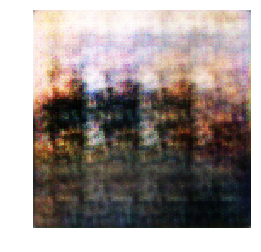

[14/500][0/99] Loss_D: 1.3961 Loss_G: 0.7937 D(x): 0.4980 D(G(z)): 0.4974 / 0.4530


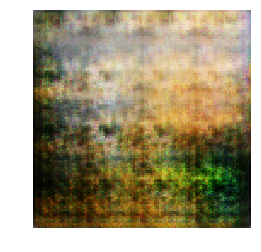

[14/500][10/99] Loss_D: 1.3673 Loss_G: 0.7595 D(x): 0.4729 D(G(z)): 0.4550 / 0.4734


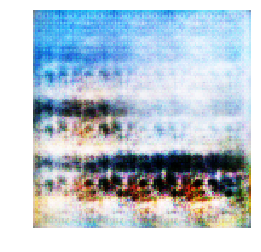

[14/500][20/99] Loss_D: 1.3464 Loss_G: 0.7469 D(x): 0.4951 D(G(z)): 0.4698 / 0.4758


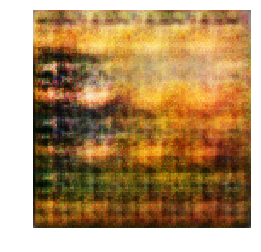

[14/500][30/99] Loss_D: 1.3737 Loss_G: 0.8029 D(x): 0.4832 D(G(z)): 0.4616 / 0.4508


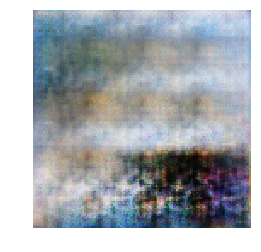

[14/500][40/99] Loss_D: 1.4200 Loss_G: 0.7651 D(x): 0.4926 D(G(z)): 0.5021 / 0.4661


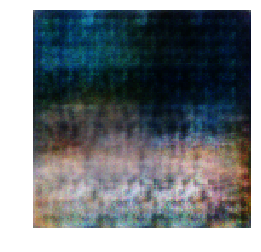

[14/500][50/99] Loss_D: 1.4332 Loss_G: 0.7857 D(x): 0.4800 D(G(z)): 0.4948 / 0.4571


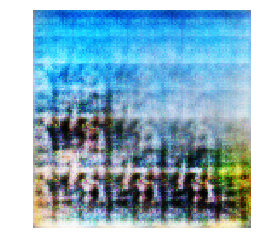

[14/500][60/99] Loss_D: 1.4349 Loss_G: 0.7896 D(x): 0.4704 D(G(z)): 0.4850 / 0.4562


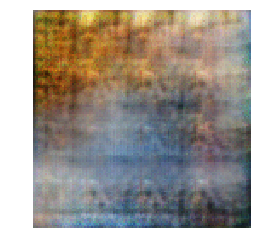

[14/500][70/99] Loss_D: 1.3549 Loss_G: 0.7723 D(x): 0.5015 D(G(z)): 0.4757 / 0.4675


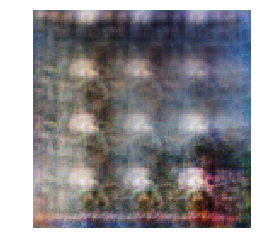

[14/500][80/99] Loss_D: 1.4180 Loss_G: 0.8685 D(x): 0.4367 D(G(z)): 0.4352 / 0.4227


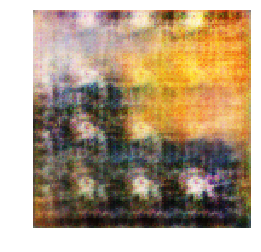

[14/500][90/99] Loss_D: 1.3760 Loss_G: 0.7763 D(x): 0.4754 D(G(z)): 0.4639 / 0.4632


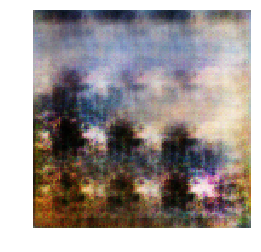

[15/500][0/99] Loss_D: 1.4655 Loss_G: 0.8709 D(x): 0.4565 D(G(z)): 0.4781 / 0.4254


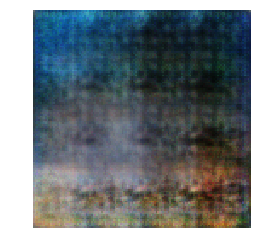

[15/500][10/99] Loss_D: 1.3747 Loss_G: 0.8195 D(x): 0.5150 D(G(z)): 0.4955 / 0.4423


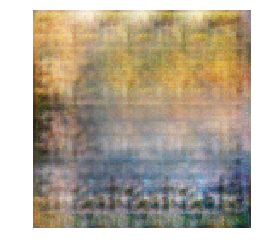

[15/500][20/99] Loss_D: 1.3930 Loss_G: 0.7656 D(x): 0.4877 D(G(z)): 0.4868 / 0.4660


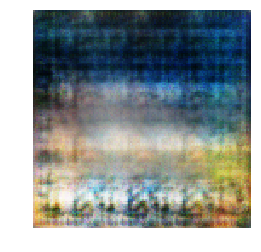

[15/500][30/99] Loss_D: 1.3926 Loss_G: 0.7858 D(x): 0.4993 D(G(z)): 0.4967 / 0.4568


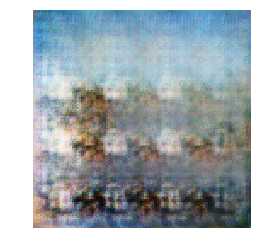

[15/500][40/99] Loss_D: 1.3772 Loss_G: 0.7247 D(x): 0.5017 D(G(z)): 0.4911 / 0.4870


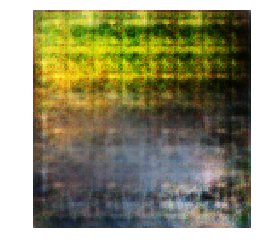

[15/500][50/99] Loss_D: 1.3752 Loss_G: 0.7724 D(x): 0.4937 D(G(z)): 0.4769 / 0.4643


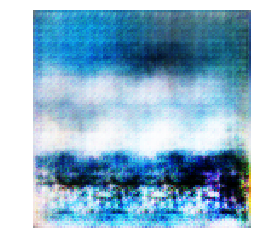

[15/500][60/99] Loss_D: 1.3859 Loss_G: 0.7969 D(x): 0.4721 D(G(z)): 0.4635 / 0.4526


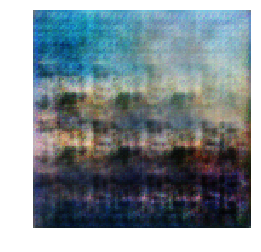

[15/500][70/99] Loss_D: 1.3957 Loss_G: 0.7733 D(x): 0.4850 D(G(z)): 0.4802 / 0.4637


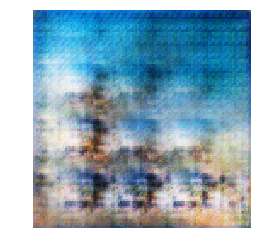

[15/500][80/99] Loss_D: 1.3589 Loss_G: 0.7794 D(x): 0.4977 D(G(z)): 0.4793 / 0.4599


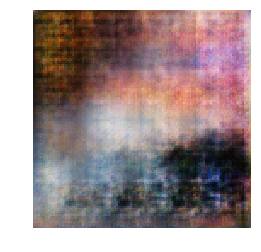

[15/500][90/99] Loss_D: 1.4121 Loss_G: 0.8201 D(x): 0.4559 D(G(z)): 0.4605 / 0.4433


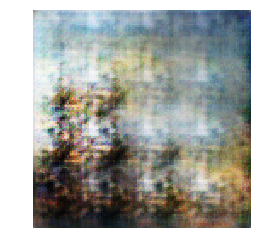

[16/500][0/99] Loss_D: 1.3802 Loss_G: 0.7273 D(x): 0.4970 D(G(z)): 0.4858 / 0.4870


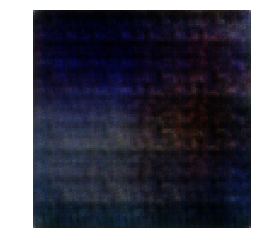

[16/500][10/99] Loss_D: 1.3492 Loss_G: 0.7275 D(x): 0.4922 D(G(z)): 0.4690 / 0.4844


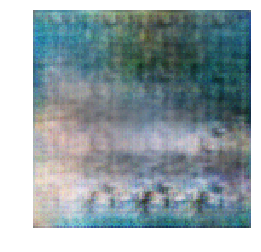

[16/500][20/99] Loss_D: 1.4026 Loss_G: 0.7529 D(x): 0.4947 D(G(z)): 0.4914 / 0.4717


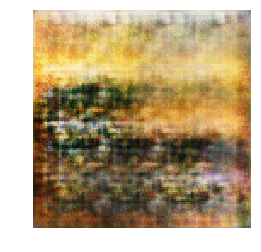

[16/500][30/99] Loss_D: 1.3083 Loss_G: 0.7002 D(x): 0.5540 D(G(z)): 0.5058 / 0.4988


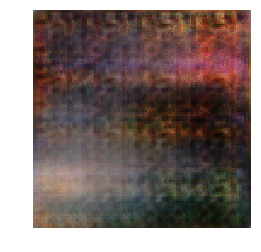

[16/500][40/99] Loss_D: 1.3272 Loss_G: 0.7487 D(x): 0.5308 D(G(z)): 0.4928 / 0.4757


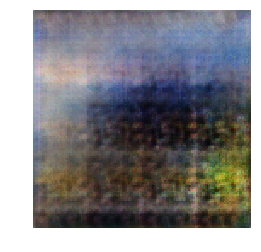

[16/500][50/99] Loss_D: 1.4226 Loss_G: 0.8374 D(x): 0.4970 D(G(z)): 0.4973 / 0.4349


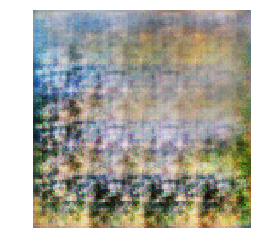

[16/500][60/99] Loss_D: 1.3532 Loss_G: 0.7404 D(x): 0.5355 D(G(z)): 0.5114 / 0.4786


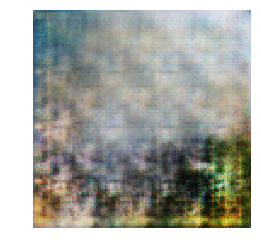

[16/500][70/99] Loss_D: 1.3769 Loss_G: 0.7710 D(x): 0.4831 D(G(z)): 0.4718 / 0.4646


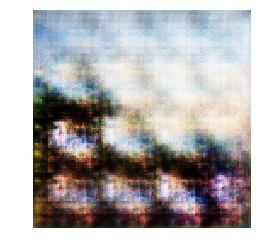

[16/500][80/99] Loss_D: 1.3829 Loss_G: 0.7493 D(x): 0.5285 D(G(z)): 0.5099 / 0.4745


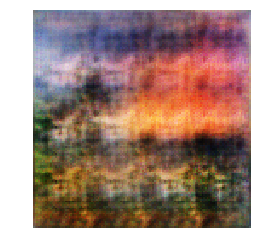

[16/500][90/99] Loss_D: 1.3785 Loss_G: 0.7172 D(x): 0.5118 D(G(z)): 0.5002 / 0.4891


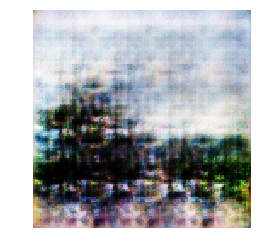

[17/500][0/99] Loss_D: 1.3242 Loss_G: 0.7807 D(x): 0.5052 D(G(z)): 0.4612 / 0.4608


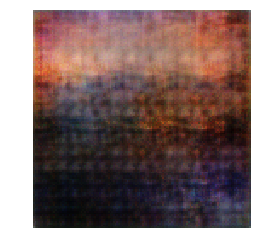

[17/500][10/99] Loss_D: 1.4060 Loss_G: 0.8003 D(x): 0.4946 D(G(z)): 0.4886 / 0.4501


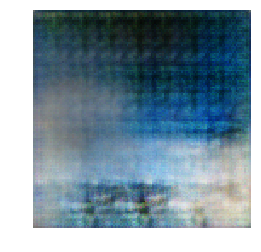

[17/500][20/99] Loss_D: 1.3744 Loss_G: 0.7907 D(x): 0.4923 D(G(z)): 0.4762 / 0.4557


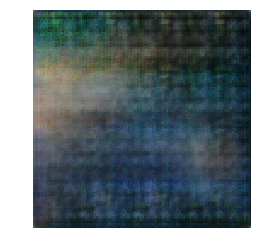

[17/500][30/99] Loss_D: 1.3381 Loss_G: 0.7562 D(x): 0.5253 D(G(z)): 0.4924 / 0.4708


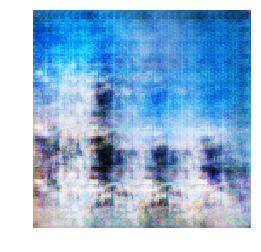

[17/500][40/99] Loss_D: 1.3641 Loss_G: 0.7509 D(x): 0.5803 D(G(z)): 0.5441 / 0.4734


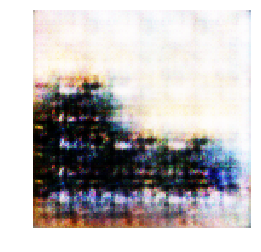

[17/500][50/99] Loss_D: 1.4249 Loss_G: 0.7643 D(x): 0.4841 D(G(z)): 0.4947 / 0.4666


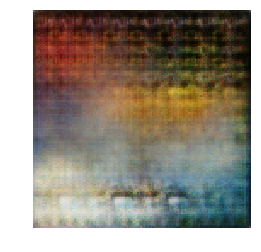

[17/500][60/99] Loss_D: 1.3612 Loss_G: 0.7414 D(x): 0.5132 D(G(z)): 0.4946 / 0.4781


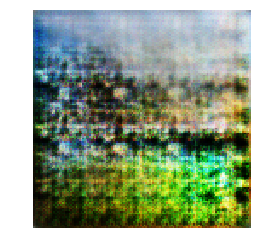

[17/500][70/99] Loss_D: 1.4163 Loss_G: 0.8017 D(x): 0.4627 D(G(z)): 0.4696 / 0.4497


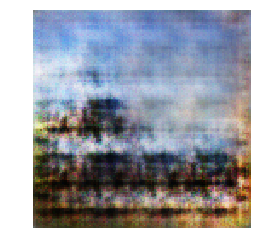

[17/500][80/99] Loss_D: 1.4019 Loss_G: 0.7321 D(x): 0.5187 D(G(z)): 0.5174 / 0.4833


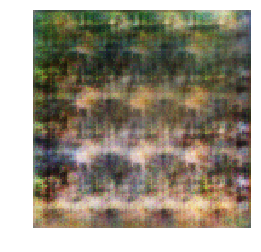

[17/500][90/99] Loss_D: 1.3922 Loss_G: 0.7447 D(x): 0.5057 D(G(z)): 0.4957 / 0.4785


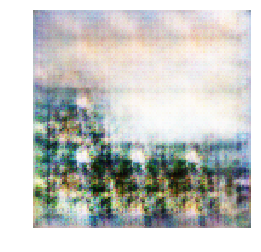

[18/500][0/99] Loss_D: 1.4271 Loss_G: 0.7834 D(x): 0.4772 D(G(z)): 0.4880 / 0.4591


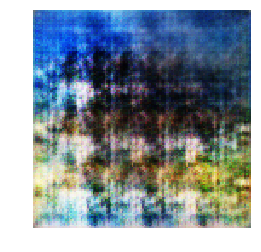

[18/500][10/99] Loss_D: 1.4018 Loss_G: 0.7995 D(x): 0.4749 D(G(z)): 0.4693 / 0.4530


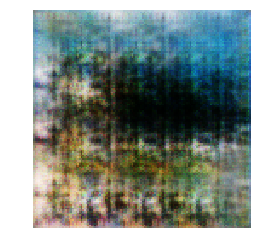

[18/500][20/99] Loss_D: 1.3703 Loss_G: 0.8005 D(x): 0.4702 D(G(z)): 0.4560 / 0.4505


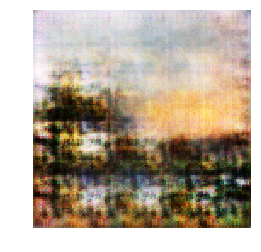

[18/500][30/99] Loss_D: 1.3882 Loss_G: 0.7507 D(x): 0.4707 D(G(z)): 0.4663 / 0.4737


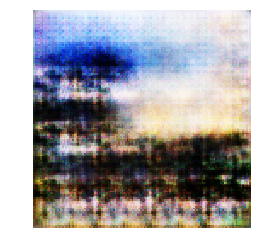

[18/500][40/99] Loss_D: 1.3938 Loss_G: 0.7369 D(x): 0.4870 D(G(z)): 0.4830 / 0.4816


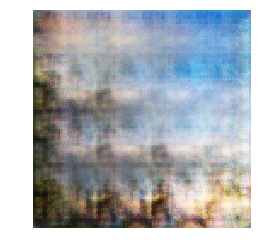

[18/500][50/99] Loss_D: 1.3975 Loss_G: 0.7979 D(x): 0.4715 D(G(z)): 0.4707 / 0.4514


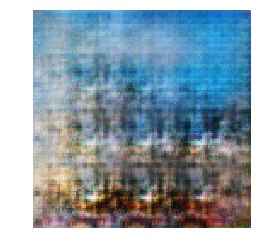

[18/500][60/99] Loss_D: 1.3826 Loss_G: 0.7499 D(x): 0.4771 D(G(z)): 0.4688 / 0.4754


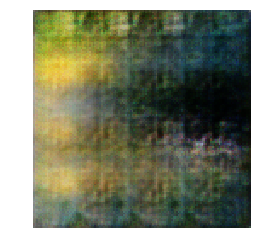

[18/500][70/99] Loss_D: 1.3475 Loss_G: 0.6968 D(x): 0.5206 D(G(z)): 0.4942 / 0.5008


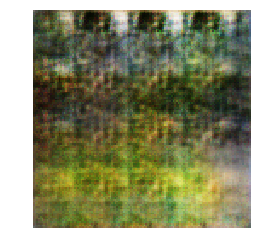

[18/500][80/99] Loss_D: 1.3926 Loss_G: 0.7536 D(x): 0.4949 D(G(z)): 0.4938 / 0.4719


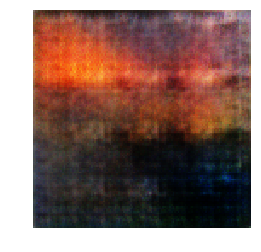

[18/500][90/99] Loss_D: 1.3799 Loss_G: 0.7875 D(x): 0.4627 D(G(z)): 0.4533 / 0.4555


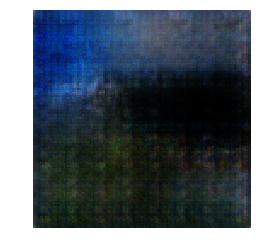

[19/500][0/99] Loss_D: 1.4025 Loss_G: 0.8279 D(x): 0.4388 D(G(z)): 0.4340 / 0.4387


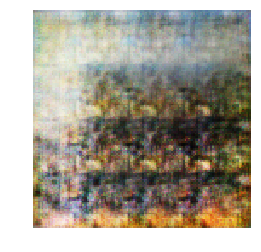

[19/500][10/99] Loss_D: 1.3829 Loss_G: 0.7230 D(x): 0.4969 D(G(z)): 0.4917 / 0.4868


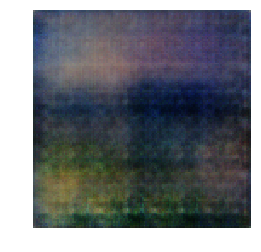

[19/500][20/99] Loss_D: 1.3976 Loss_G: 0.7121 D(x): 0.5031 D(G(z)): 0.5008 / 0.4922


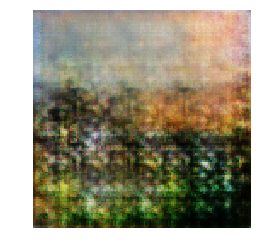

[19/500][30/99] Loss_D: 1.3919 Loss_G: 0.8110 D(x): 0.4851 D(G(z)): 0.4755 / 0.4451


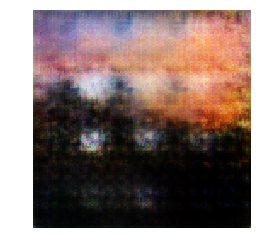

[19/500][40/99] Loss_D: 1.3861 Loss_G: 0.7286 D(x): 0.5126 D(G(z)): 0.5063 / 0.4841


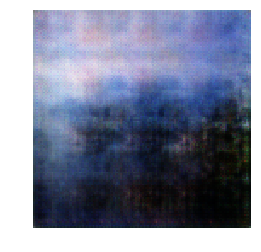

[19/500][50/99] Loss_D: 1.3920 Loss_G: 0.8391 D(x): 0.4560 D(G(z)): 0.4468 / 0.4336


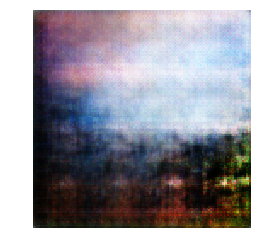

[19/500][60/99] Loss_D: 1.3988 Loss_G: 0.7450 D(x): 0.5163 D(G(z)): 0.5149 / 0.4795


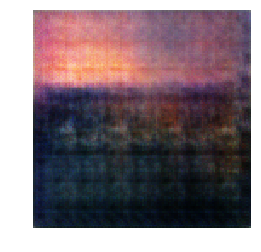

[19/500][70/99] Loss_D: 1.3863 Loss_G: 0.7615 D(x): 0.4599 D(G(z)): 0.4535 / 0.4693


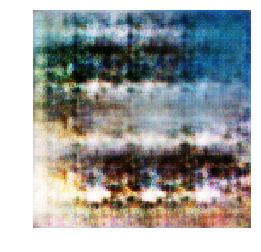

[19/500][80/99] Loss_D: 1.4691 Loss_G: 0.8194 D(x): 0.5312 D(G(z)): 0.5333 / 0.4424


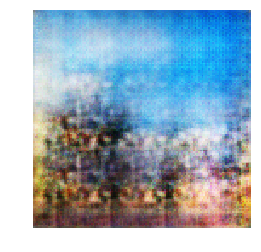

[19/500][90/99] Loss_D: 1.4137 Loss_G: 0.8041 D(x): 0.4504 D(G(z)): 0.4503 / 0.4551


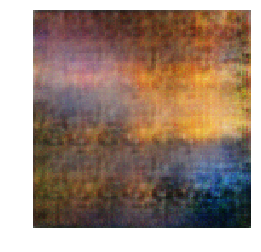

[20/500][0/99] Loss_D: 1.3976 Loss_G: 0.7497 D(x): 0.4872 D(G(z)): 0.4873 / 0.4755


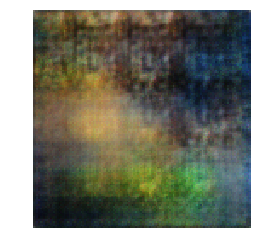

[20/500][10/99] Loss_D: 1.4050 Loss_G: 0.7920 D(x): 0.4601 D(G(z)): 0.4626 / 0.4539


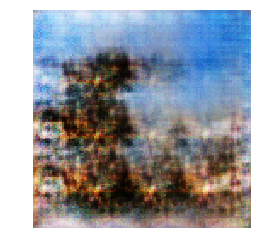

[20/500][20/99] Loss_D: 1.3884 Loss_G: 0.7722 D(x): 0.4777 D(G(z)): 0.4747 / 0.4624


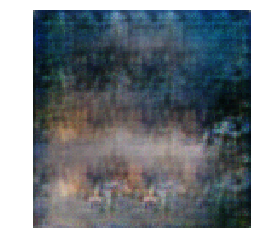

[20/500][30/99] Loss_D: 1.4021 Loss_G: 0.7599 D(x): 0.4620 D(G(z)): 0.4639 / 0.4690


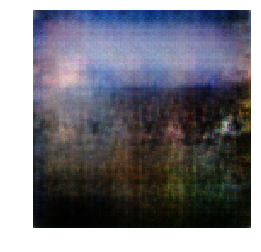

[20/500][40/99] Loss_D: 1.3649 Loss_G: 0.7686 D(x): 0.4874 D(G(z)): 0.4692 / 0.4645


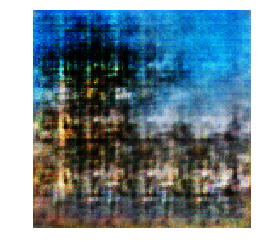

[20/500][50/99] Loss_D: 1.3873 Loss_G: 0.7439 D(x): 0.4817 D(G(z)): 0.4781 / 0.4760


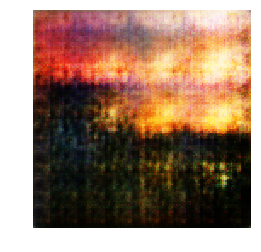

[20/500][60/99] Loss_D: 1.3955 Loss_G: 0.7901 D(x): 0.4658 D(G(z)): 0.4654 / 0.4552


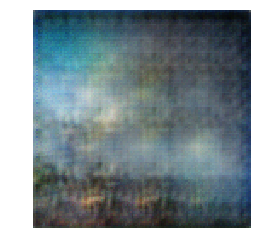

[20/500][70/99] Loss_D: 1.3757 Loss_G: 0.7293 D(x): 0.4975 D(G(z)): 0.4865 / 0.4834


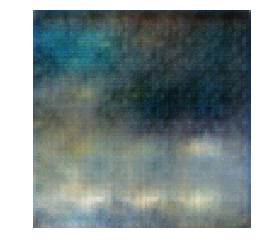

[20/500][80/99] Loss_D: 1.3977 Loss_G: 0.7771 D(x): 0.4676 D(G(z)): 0.4700 / 0.4602


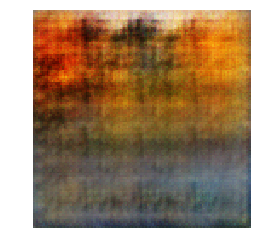

[20/500][90/99] Loss_D: 1.4072 Loss_G: 0.7625 D(x): 0.4666 D(G(z)): 0.4716 / 0.4679


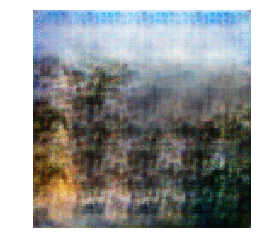

[21/500][0/99] Loss_D: 1.3764 Loss_G: 0.7939 D(x): 0.4671 D(G(z)): 0.4548 / 0.4544


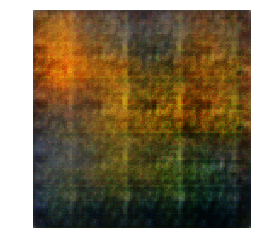

[21/500][10/99] Loss_D: 1.4110 Loss_G: 0.7675 D(x): 0.4629 D(G(z)): 0.4706 / 0.4644


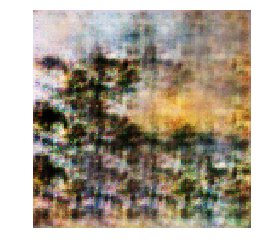

[21/500][20/99] Loss_D: 1.3909 Loss_G: 0.7495 D(x): 0.4749 D(G(z)): 0.4722 / 0.4735


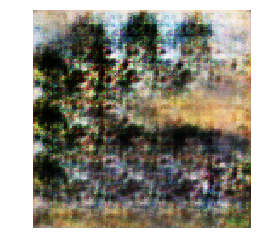

[21/500][30/99] Loss_D: 1.3990 Loss_G: 0.7147 D(x): 0.4964 D(G(z)): 0.5008 / 0.4901


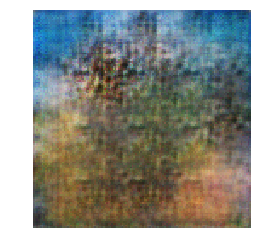

[21/500][40/99] Loss_D: 1.3923 Loss_G: 0.7701 D(x): 0.5342 D(G(z)): 0.5041 / 0.4640


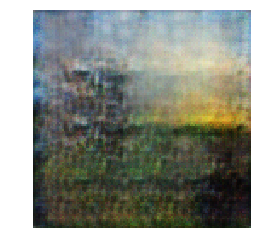

[21/500][50/99] Loss_D: 1.3772 Loss_G: 0.7224 D(x): 0.5012 D(G(z)): 0.4894 / 0.4893


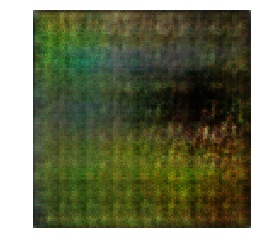

[21/500][60/99] Loss_D: 1.3743 Loss_G: 0.7796 D(x): 0.4722 D(G(z)): 0.4595 / 0.4594


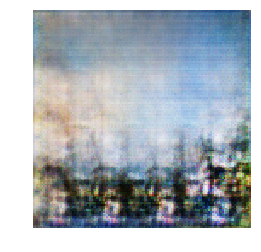

[21/500][70/99] Loss_D: 1.4502 Loss_G: 0.7268 D(x): 0.5225 D(G(z)): 0.5377 / 0.4846


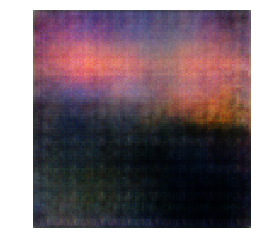

[21/500][80/99] Loss_D: 1.3999 Loss_G: 0.7779 D(x): 0.4729 D(G(z)): 0.4753 / 0.4597


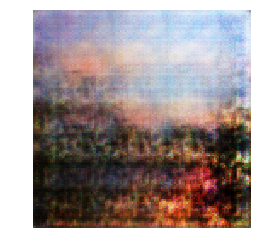

[21/500][90/99] Loss_D: 1.3986 Loss_G: 0.7602 D(x): 0.4652 D(G(z)): 0.4681 / 0.4682


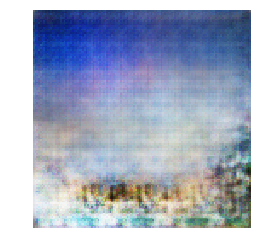

[22/500][0/99] Loss_D: 1.4161 Loss_G: 0.7812 D(x): 0.5168 D(G(z)): 0.5106 / 0.4590


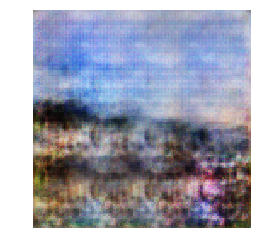

[22/500][10/99] Loss_D: 1.3847 Loss_G: 0.7346 D(x): 0.4998 D(G(z)): 0.4964 / 0.4801


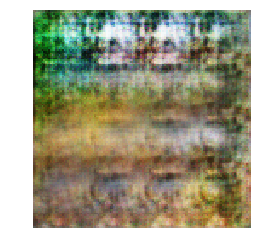

[22/500][20/99] Loss_D: 1.4100 Loss_G: 0.7879 D(x): 0.4499 D(G(z)): 0.4556 / 0.4561


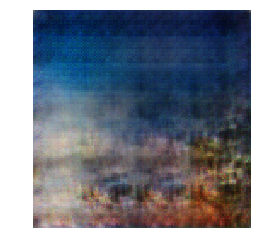

[22/500][30/99] Loss_D: 1.3898 Loss_G: 0.7406 D(x): 0.5052 D(G(z)): 0.5022 / 0.4772


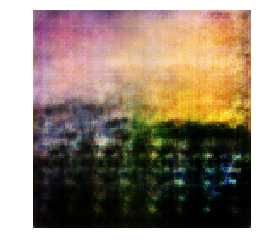

[22/500][40/99] Loss_D: 1.4069 Loss_G: 0.7701 D(x): 0.4847 D(G(z)): 0.4898 / 0.4638


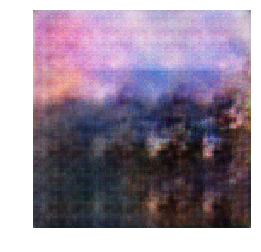

[22/500][50/99] Loss_D: 1.3652 Loss_G: 0.7192 D(x): 0.5236 D(G(z)): 0.5032 / 0.4887


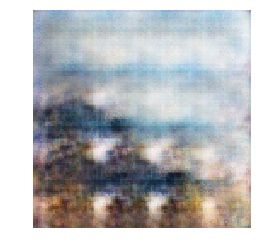

[22/500][60/99] Loss_D: 1.4122 Loss_G: 0.7998 D(x): 0.4616 D(G(z)): 0.4642 / 0.4509


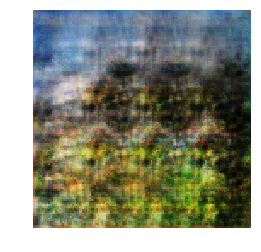

[22/500][70/99] Loss_D: 1.4272 Loss_G: 0.8130 D(x): 0.5112 D(G(z)): 0.5073 / 0.4439


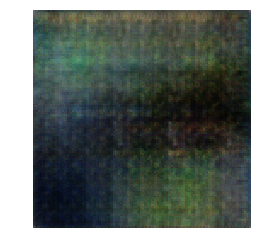

[22/500][80/99] Loss_D: 1.3822 Loss_G: 0.7556 D(x): 0.4675 D(G(z)): 0.4604 / 0.4707


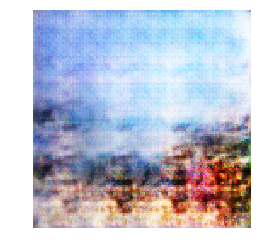

[22/500][90/99] Loss_D: 1.3934 Loss_G: 0.7859 D(x): 0.4653 D(G(z)): 0.4612 / 0.4577


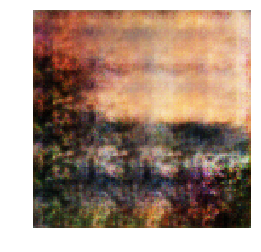

[23/500][0/99] Loss_D: 1.4299 Loss_G: 0.7494 D(x): 0.4654 D(G(z)): 0.4838 / 0.4734


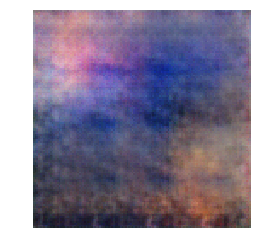

[23/500][10/99] Loss_D: 1.3723 Loss_G: 0.7155 D(x): 0.4682 D(G(z)): 0.4549 / 0.4956


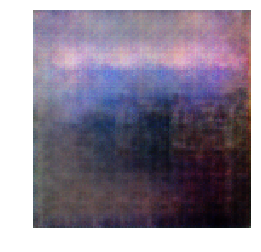

[23/500][20/99] Loss_D: 1.4059 Loss_G: 0.7838 D(x): 0.5166 D(G(z)): 0.5050 / 0.4570


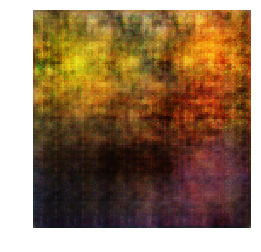

[23/500][30/99] Loss_D: 1.3763 Loss_G: 0.7324 D(x): 0.4989 D(G(z)): 0.4853 / 0.4839


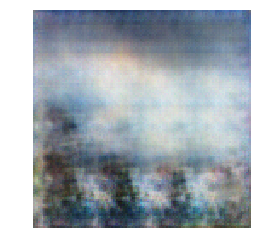

[23/500][40/99] Loss_D: 1.4375 Loss_G: 0.7677 D(x): 0.4592 D(G(z)): 0.4800 / 0.4651


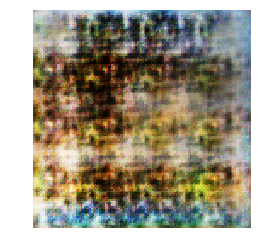

[23/500][50/99] Loss_D: 1.3640 Loss_G: 0.7354 D(x): 0.4842 D(G(z)): 0.4682 / 0.4823


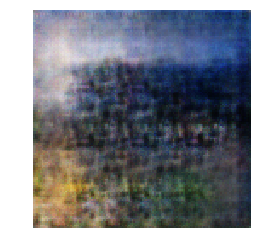

[23/500][60/99] Loss_D: 1.4533 Loss_G: 0.7879 D(x): 0.5561 D(G(z)): 0.5474 / 0.4562


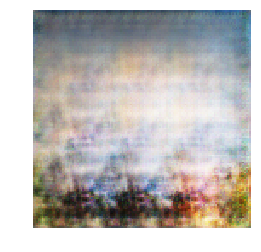

[23/500][70/99] Loss_D: 1.4005 Loss_G: 0.7439 D(x): 0.4846 D(G(z)): 0.4878 / 0.4757


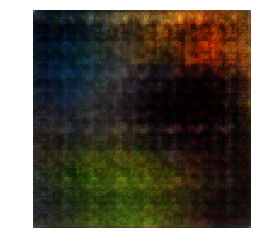

[23/500][80/99] Loss_D: 1.4022 Loss_G: 0.7529 D(x): 0.4913 D(G(z)): 0.4929 / 0.4718


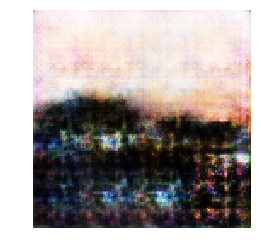

[23/500][90/99] Loss_D: 1.3605 Loss_G: 0.7641 D(x): 0.5374 D(G(z)): 0.5051 / 0.4667


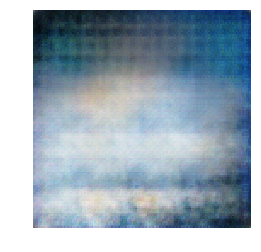

[24/500][0/99] Loss_D: 1.3925 Loss_G: 0.7631 D(x): 0.4680 D(G(z)): 0.4681 / 0.4667


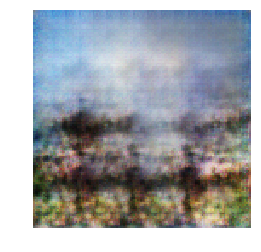

[24/500][10/99] Loss_D: 1.3899 Loss_G: 0.7728 D(x): 0.4629 D(G(z)): 0.4606 / 0.4620


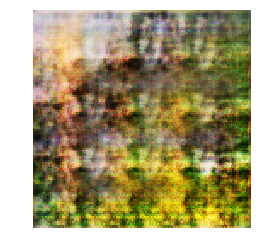

[24/500][20/99] Loss_D: 1.3592 Loss_G: 0.7141 D(x): 0.5171 D(G(z)): 0.4974 / 0.4903


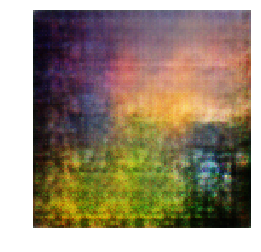

[24/500][30/99] Loss_D: 1.3662 Loss_G: 0.7120 D(x): 0.4944 D(G(z)): 0.4824 / 0.4917


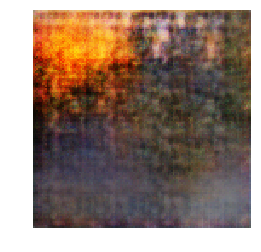

[24/500][40/99] Loss_D: 1.4000 Loss_G: 0.7365 D(x): 0.4756 D(G(z)): 0.4792 / 0.4793


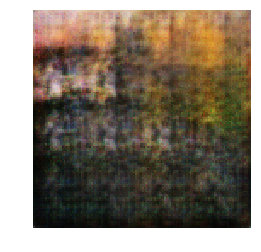

[24/500][50/99] Loss_D: 1.3647 Loss_G: 0.7679 D(x): 0.5087 D(G(z)): 0.4816 / 0.4656


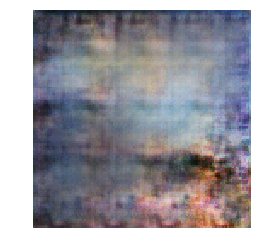

[24/500][60/99] Loss_D: 1.3785 Loss_G: 0.7001 D(x): 0.4863 D(G(z)): 0.4781 / 0.4981


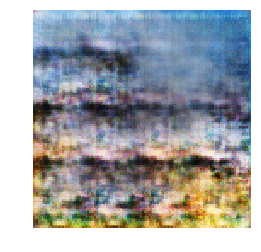

[24/500][70/99] Loss_D: 1.3952 Loss_G: 0.7335 D(x): 0.4800 D(G(z)): 0.4814 / 0.4806


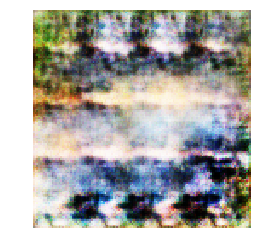

[24/500][80/99] Loss_D: 1.4234 Loss_G: 0.7259 D(x): 0.5142 D(G(z)): 0.5213 / 0.4852


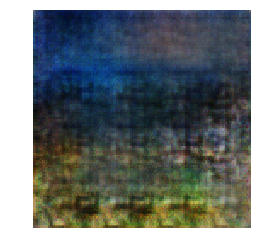

[24/500][90/99] Loss_D: 1.4295 Loss_G: 0.7929 D(x): 0.4511 D(G(z)): 0.4673 / 0.4529


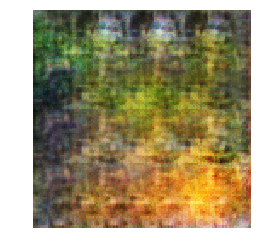

[25/500][0/99] Loss_D: 1.3832 Loss_G: 0.6680 D(x): 0.4912 D(G(z)): 0.4877 / 0.5159


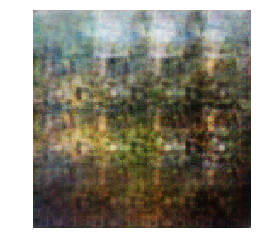

[25/500][10/99] Loss_D: 1.3845 Loss_G: 0.7360 D(x): 0.5191 D(G(z)): 0.5042 / 0.4796


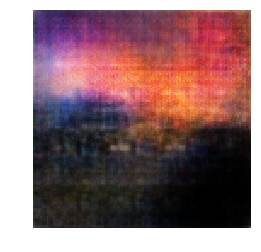

[25/500][20/99] Loss_D: 1.4014 Loss_G: 0.7377 D(x): 0.5031 D(G(z)): 0.5005 / 0.4795


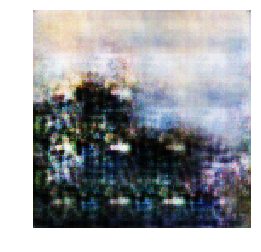

[25/500][30/99] Loss_D: 1.4069 Loss_G: 0.7658 D(x): 0.4820 D(G(z)): 0.4867 / 0.4656


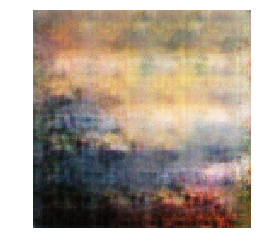

[25/500][40/99] Loss_D: 1.3988 Loss_G: 0.7191 D(x): 0.4887 D(G(z)): 0.4928 / 0.4880


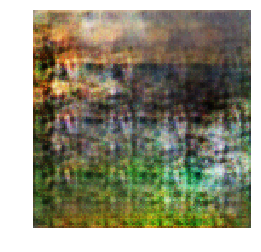

[25/500][50/99] Loss_D: 1.3832 Loss_G: 0.7103 D(x): 0.5043 D(G(z)): 0.4998 / 0.4922


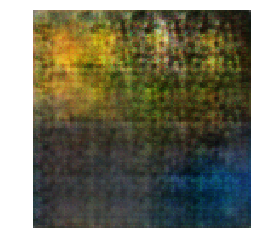

[25/500][60/99] Loss_D: 1.3907 Loss_G: 0.7383 D(x): 0.4876 D(G(z)): 0.4875 / 0.4783


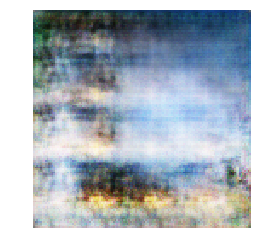

[25/500][70/99] Loss_D: 1.3917 Loss_G: 0.7932 D(x): 0.4700 D(G(z)): 0.4693 / 0.4529


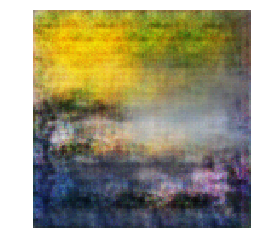

[25/500][80/99] Loss_D: 1.4147 Loss_G: 0.7998 D(x): 0.4709 D(G(z)): 0.4788 / 0.4499


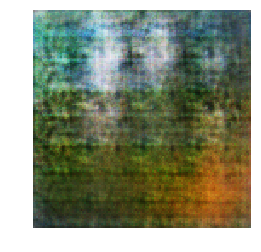

[25/500][90/99] Loss_D: 1.4026 Loss_G: 0.7768 D(x): 0.4568 D(G(z)): 0.4606 / 0.4601


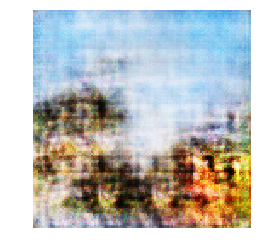

[26/500][0/99] Loss_D: 1.3970 Loss_G: 0.7084 D(x): 0.5058 D(G(z)): 0.5031 / 0.4942


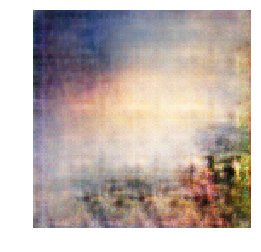

[26/500][10/99] Loss_D: 1.3919 Loss_G: 0.7493 D(x): 0.4673 D(G(z)): 0.4672 / 0.4735


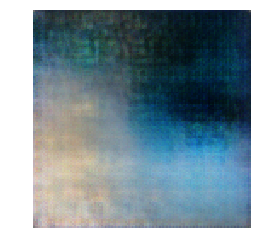

[26/500][20/99] Loss_D: 1.4658 Loss_G: 0.7139 D(x): 0.5037 D(G(z)): 0.5322 / 0.4905


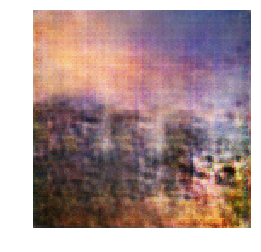

[26/500][30/99] Loss_D: 1.3966 Loss_G: 0.7465 D(x): 0.4743 D(G(z)): 0.4769 / 0.4744


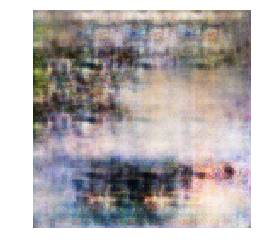

[26/500][40/99] Loss_D: 1.4148 Loss_G: 0.7353 D(x): 0.4987 D(G(z)): 0.5038 / 0.4810


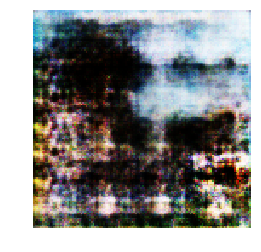

[26/500][50/99] Loss_D: 1.4136 Loss_G: 0.7317 D(x): 0.4848 D(G(z)): 0.4958 / 0.4821


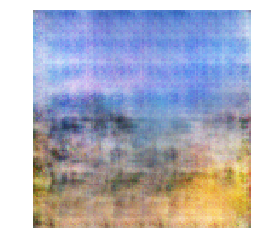

[26/500][60/99] Loss_D: 1.4033 Loss_G: 0.7546 D(x): 0.4813 D(G(z)): 0.4850 / 0.4712


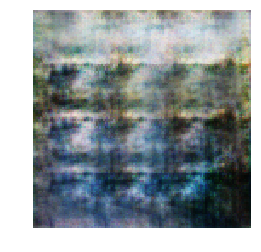

[26/500][70/99] Loss_D: 1.3852 Loss_G: 0.7353 D(x): 0.5155 D(G(z)): 0.5081 / 0.4801


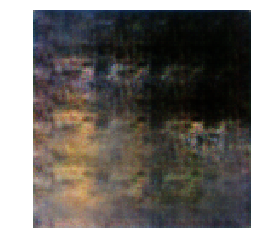

[26/500][80/99] Loss_D: 1.3819 Loss_G: 0.7465 D(x): 0.4851 D(G(z)): 0.4788 / 0.4753


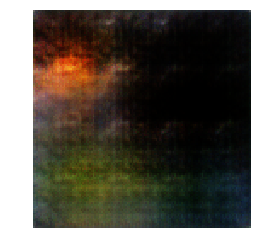

[26/500][90/99] Loss_D: 1.3695 Loss_G: 0.6780 D(x): 0.5291 D(G(z)): 0.5145 / 0.5105


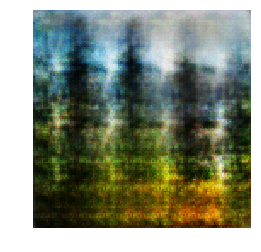

[27/500][0/99] Loss_D: 1.3941 Loss_G: 0.6878 D(x): 0.5065 D(G(z)): 0.5077 / 0.5037


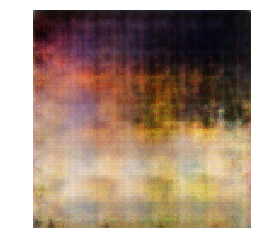

[27/500][10/99] Loss_D: 1.3920 Loss_G: 0.7761 D(x): 0.4675 D(G(z)): 0.4671 / 0.4606


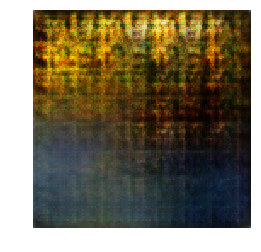

[27/500][20/99] Loss_D: 1.4216 Loss_G: 0.7491 D(x): 0.4808 D(G(z)): 0.4956 / 0.4732


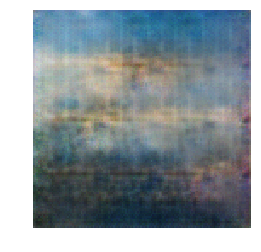

[27/500][30/99] Loss_D: 1.3681 Loss_G: 0.7144 D(x): 0.4969 D(G(z)): 0.4848 / 0.4904


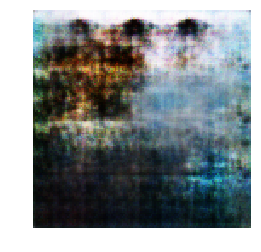

[27/500][40/99] Loss_D: 1.4016 Loss_G: 0.7501 D(x): 0.4717 D(G(z)): 0.4765 / 0.4730


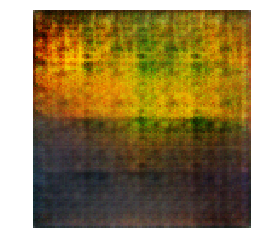

[27/500][50/99] Loss_D: 1.3710 Loss_G: 0.7514 D(x): 0.5016 D(G(z)): 0.4895 / 0.4724


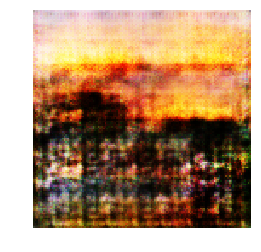

[27/500][60/99] Loss_D: 1.3822 Loss_G: 0.7730 D(x): 0.5303 D(G(z)): 0.5110 / 0.4625


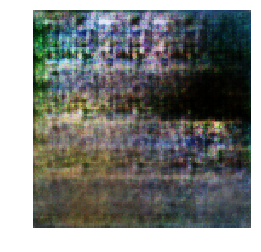

[27/500][70/99] Loss_D: 1.3952 Loss_G: 0.7494 D(x): 0.4751 D(G(z)): 0.4770 / 0.4731


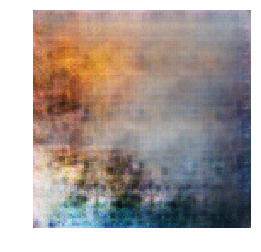

[27/500][80/99] Loss_D: 1.3943 Loss_G: 0.7355 D(x): 0.4762 D(G(z)): 0.4759 / 0.4806


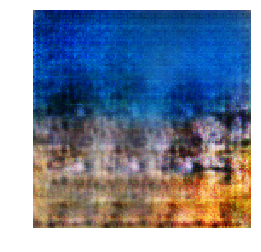

[27/500][90/99] Loss_D: 1.3843 Loss_G: 0.7444 D(x): 0.4811 D(G(z)): 0.4769 / 0.4756


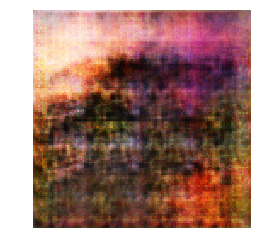

[28/500][0/99] Loss_D: 1.4081 Loss_G: 0.7289 D(x): 0.4905 D(G(z)): 0.4948 / 0.4845


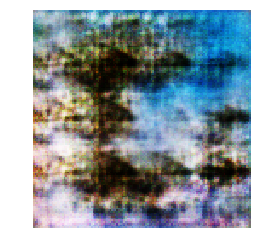

[28/500][10/99] Loss_D: 1.3874 Loss_G: 0.7052 D(x): 0.4895 D(G(z)): 0.4852 / 0.4970


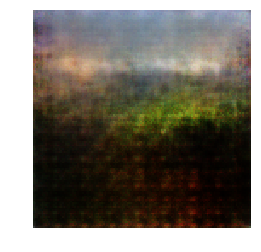

[28/500][20/99] Loss_D: 1.3792 Loss_G: 0.7477 D(x): 0.4880 D(G(z)): 0.4790 / 0.4741


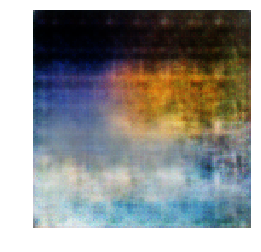

[28/500][30/99] Loss_D: 1.3775 Loss_G: 0.7275 D(x): 0.4834 D(G(z)): 0.4740 / 0.4848


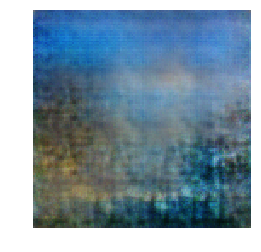

[28/500][40/99] Loss_D: 1.4159 Loss_G: 0.7510 D(x): 0.4729 D(G(z)): 0.4850 / 0.4721


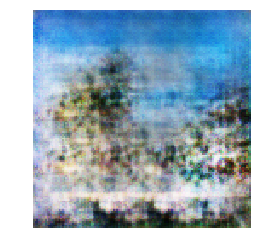

[28/500][50/99] Loss_D: 1.3719 Loss_G: 0.7731 D(x): 0.4863 D(G(z)): 0.4750 / 0.4621


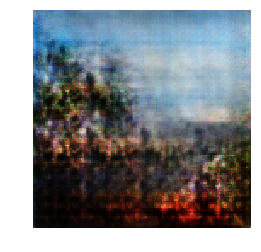

[28/500][60/99] Loss_D: 1.3664 Loss_G: 0.7369 D(x): 0.5192 D(G(z)): 0.4980 / 0.4798


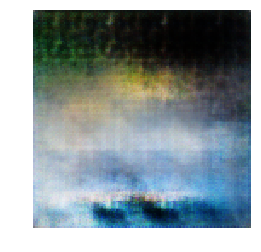

[28/500][70/99] Loss_D: 1.3895 Loss_G: 0.7872 D(x): 0.4694 D(G(z)): 0.4645 / 0.4556


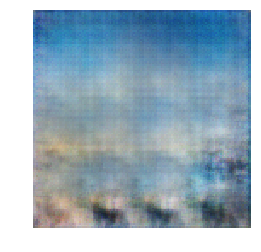

[28/500][80/99] Loss_D: 1.3745 Loss_G: 0.7022 D(x): 0.4924 D(G(z)): 0.4814 / 0.4972


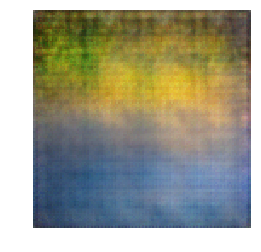

[28/500][90/99] Loss_D: 1.3667 Loss_G: 0.6787 D(x): 0.5082 D(G(z)): 0.4933 / 0.5116


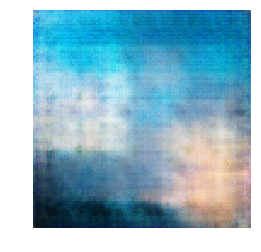

[29/500][0/99] Loss_D: 1.4008 Loss_G: 0.7081 D(x): 0.5053 D(G(z)): 0.5051 / 0.4935


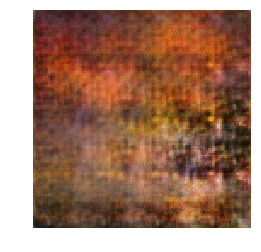

[29/500][10/99] Loss_D: 1.3675 Loss_G: 0.7676 D(x): 0.4709 D(G(z)): 0.4556 / 0.4655


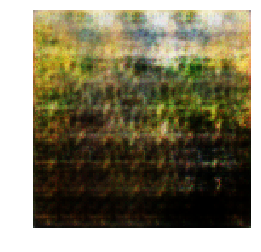

[29/500][20/99] Loss_D: 1.3942 Loss_G: 0.7399 D(x): 0.4790 D(G(z)): 0.4798 / 0.4784


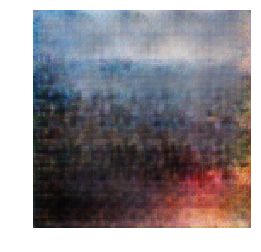

[29/500][30/99] Loss_D: 1.4197 Loss_G: 0.6979 D(x): 0.5120 D(G(z)): 0.5199 / 0.5004


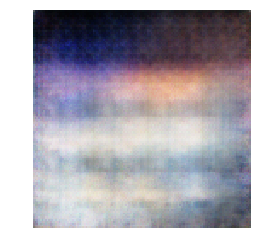

[29/500][40/99] Loss_D: 1.3639 Loss_G: 0.7225 D(x): 0.5048 D(G(z)): 0.4866 / 0.4877


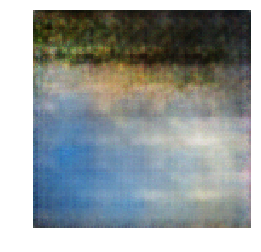

[29/500][50/99] Loss_D: 1.3903 Loss_G: 0.7197 D(x): 0.4861 D(G(z)): 0.4871 / 0.4870


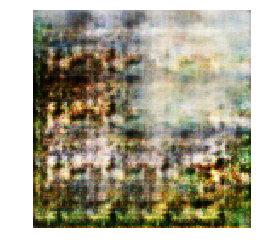

[29/500][60/99] Loss_D: 1.3857 Loss_G: 0.7043 D(x): 0.5240 D(G(z)): 0.5124 / 0.4956


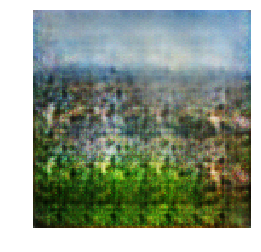

[29/500][70/99] Loss_D: 1.3790 Loss_G: 0.7357 D(x): 0.4938 D(G(z)): 0.4855 / 0.4800


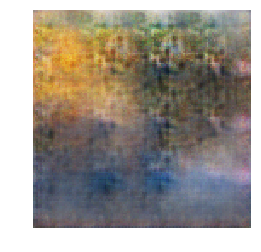

[29/500][80/99] Loss_D: 1.4047 Loss_G: 0.6939 D(x): 0.5276 D(G(z)): 0.5231 / 0.5013


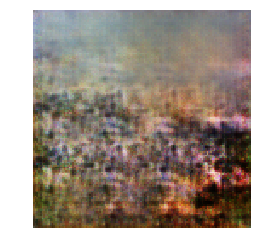

[29/500][90/99] Loss_D: 1.3984 Loss_G: 0.7622 D(x): 0.4667 D(G(z)): 0.4689 / 0.4671


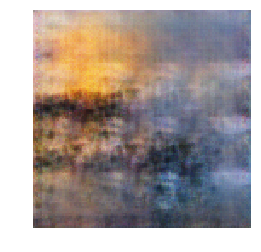

[30/500][0/99] Loss_D: 1.4100 Loss_G: 0.7242 D(x): 0.5066 D(G(z)): 0.5062 / 0.4893


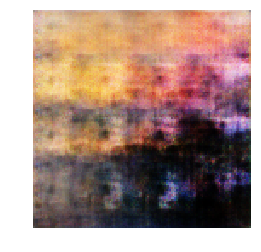

[30/500][10/99] Loss_D: 1.3932 Loss_G: 0.7636 D(x): 0.4638 D(G(z)): 0.4629 / 0.4670


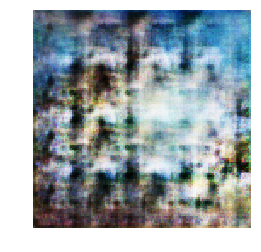

[30/500][20/99] Loss_D: 1.3791 Loss_G: 0.7407 D(x): 0.4902 D(G(z)): 0.4824 / 0.4779


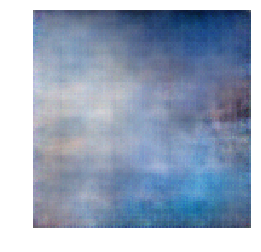

[30/500][30/99] Loss_D: 1.3972 Loss_G: 0.6910 D(x): 0.5254 D(G(z)): 0.5226 / 0.5029


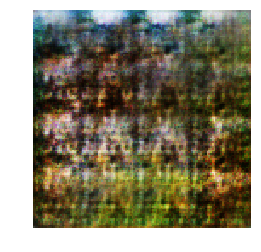

[30/500][40/99] Loss_D: 1.3808 Loss_G: 0.7526 D(x): 0.4913 D(G(z)): 0.4829 / 0.4718


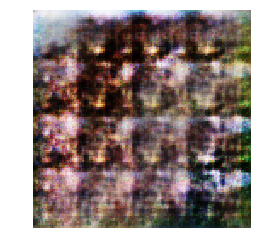

[30/500][50/99] Loss_D: 1.3632 Loss_G: 0.7005 D(x): 0.5040 D(G(z)): 0.4904 / 0.4967


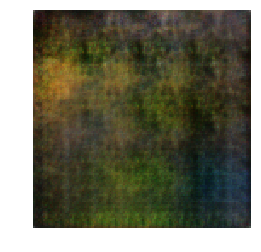

[30/500][60/99] Loss_D: 1.3865 Loss_G: 0.7595 D(x): 0.5248 D(G(z)): 0.5098 / 0.4684


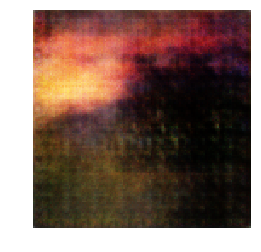

[30/500][70/99] Loss_D: 1.4100 Loss_G: 0.7192 D(x): 0.5208 D(G(z)): 0.5205 / 0.4883


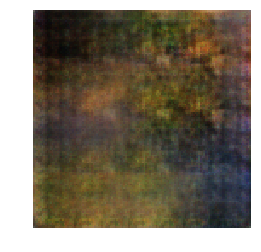

[30/500][80/99] Loss_D: 1.3940 Loss_G: 0.7586 D(x): 0.4809 D(G(z)): 0.4818 / 0.4687


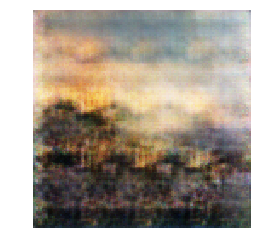

[30/500][90/99] Loss_D: 1.3628 Loss_G: 0.7015 D(x): 0.5388 D(G(z)): 0.5134 / 0.4973


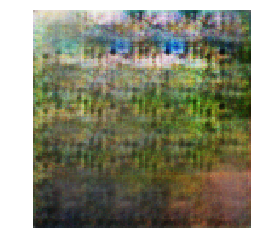

[31/500][0/99] Loss_D: 1.4223 Loss_G: 0.7001 D(x): 0.5082 D(G(z)): 0.5149 / 0.5002


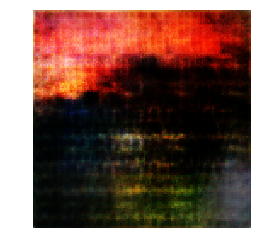

[31/500][10/99] Loss_D: 1.4179 Loss_G: 0.7386 D(x): 0.5484 D(G(z)): 0.5347 / 0.4783


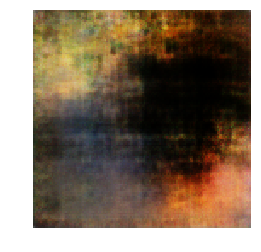

[31/500][20/99] Loss_D: 1.3801 Loss_G: 0.6899 D(x): 0.4924 D(G(z)): 0.4882 / 0.5024


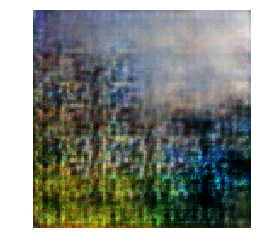

[31/500][30/99] Loss_D: 1.3935 Loss_G: 0.7584 D(x): 0.4680 D(G(z)): 0.4693 / 0.4685


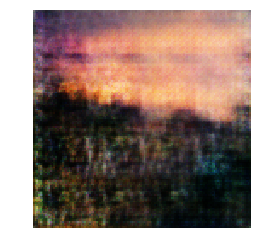

[31/500][40/99] Loss_D: 1.3923 Loss_G: 0.7616 D(x): 0.4685 D(G(z)): 0.4692 / 0.4671


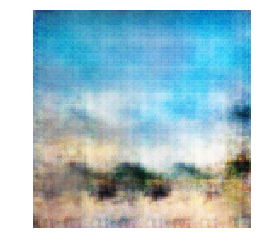

[31/500][50/99] Loss_D: 1.4010 Loss_G: 0.7260 D(x): 0.4956 D(G(z)): 0.5003 / 0.4847


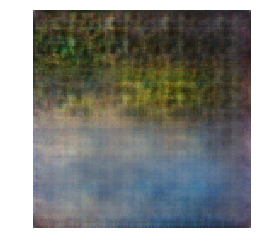

[31/500][60/99] Loss_D: 1.3581 Loss_G: 0.6712 D(x): 0.5149 D(G(z)): 0.4929 / 0.5166


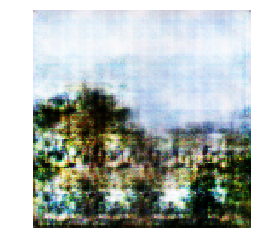

[31/500][70/99] Loss_D: 1.4112 Loss_G: 0.7690 D(x): 0.4662 D(G(z)): 0.4761 / 0.4636


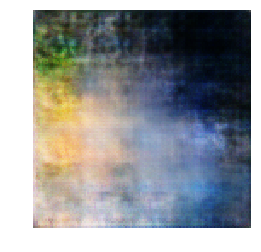

[31/500][80/99] Loss_D: 1.3850 Loss_G: 0.7038 D(x): 0.4891 D(G(z)): 0.4871 / 0.4951


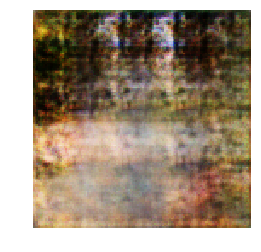

[31/500][90/99] Loss_D: 1.3893 Loss_G: 0.7237 D(x): 0.4916 D(G(z)): 0.4911 / 0.4854


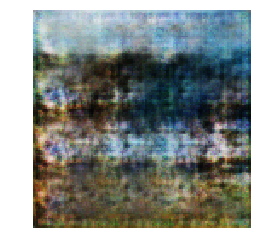

[32/500][0/99] Loss_D: 1.3687 Loss_G: 0.7153 D(x): 0.5080 D(G(z)): 0.4931 / 0.4909


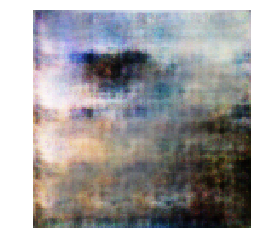

[32/500][10/99] Loss_D: 1.4026 Loss_G: 0.7468 D(x): 0.4955 D(G(z)): 0.4976 / 0.4747


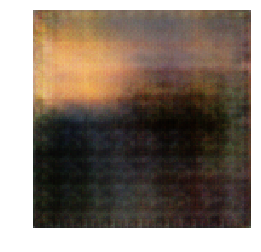

[32/500][20/99] Loss_D: 1.3760 Loss_G: 0.7251 D(x): 0.5000 D(G(z)): 0.4913 / 0.4856


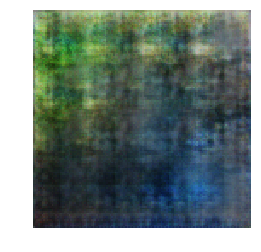

[32/500][30/99] Loss_D: 1.4086 Loss_G: 0.7423 D(x): 0.4792 D(G(z)): 0.4890 / 0.4762


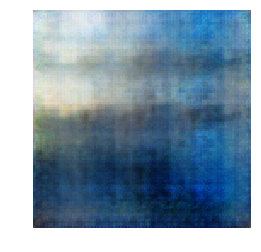

[32/500][40/99] Loss_D: 1.3801 Loss_G: 0.7643 D(x): 0.4718 D(G(z)): 0.4665 / 0.4659


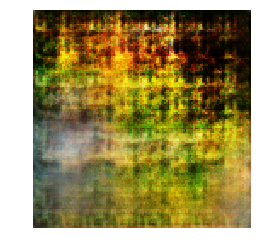

[32/500][50/99] Loss_D: 1.3947 Loss_G: 0.7340 D(x): 0.4837 D(G(z)): 0.4860 / 0.4803


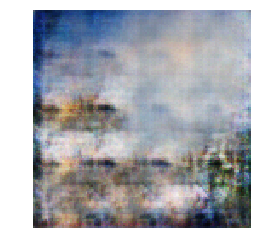

[32/500][60/99] Loss_D: 1.3673 Loss_G: 0.7076 D(x): 0.4919 D(G(z)): 0.4799 / 0.4937


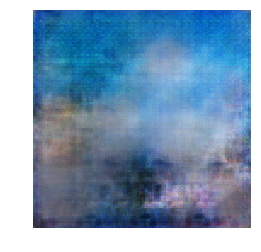

[32/500][70/99] Loss_D: 1.3777 Loss_G: 0.7175 D(x): 0.4949 D(G(z)): 0.4880 / 0.4886


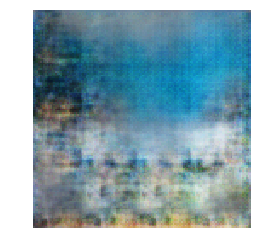

[32/500][80/99] Loss_D: 1.3984 Loss_G: 0.7667 D(x): 0.4666 D(G(z)): 0.4696 / 0.4648


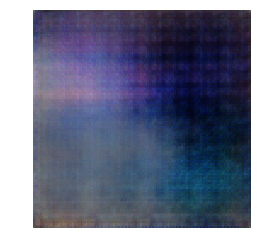

[32/500][90/99] Loss_D: 1.3626 Loss_G: 0.6694 D(x): 0.5522 D(G(z)): 0.5289 / 0.5139


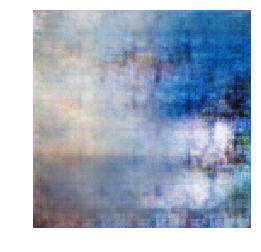

[33/500][0/99] Loss_D: 1.4116 Loss_G: 0.7336 D(x): 0.4856 D(G(z)): 0.4948 / 0.4807


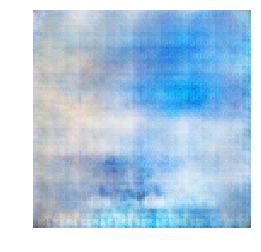

[33/500][10/99] Loss_D: 1.3831 Loss_G: 0.7288 D(x): 0.4771 D(G(z)): 0.4735 / 0.4831


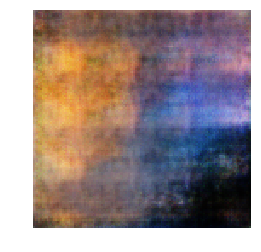

[33/500][20/99] Loss_D: 1.3849 Loss_G: 0.7152 D(x): 0.5177 D(G(z)): 0.5121 / 0.4894


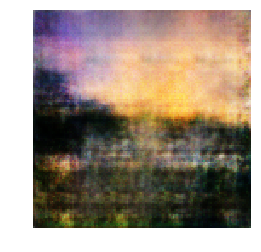

[33/500][30/99] Loss_D: 1.3865 Loss_G: 0.7463 D(x): 0.4959 D(G(z)): 0.4933 / 0.4744


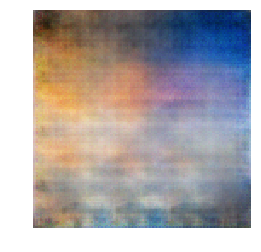

[33/500][40/99] Loss_D: 1.3839 Loss_G: 0.7191 D(x): 0.4920 D(G(z)): 0.4884 / 0.4877


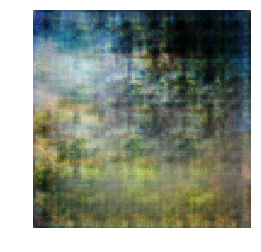

[33/500][50/99] Loss_D: 1.3927 Loss_G: 0.7345 D(x): 0.4802 D(G(z)): 0.4806 / 0.4803


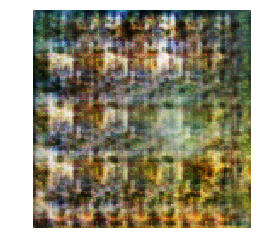

[33/500][60/99] Loss_D: 1.3768 Loss_G: 0.7481 D(x): 0.4719 D(G(z)): 0.4645 / 0.4735


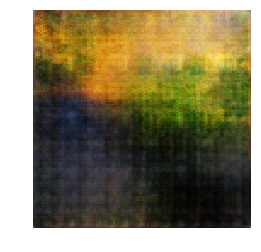

[33/500][70/99] Loss_D: 1.3819 Loss_G: 0.7291 D(x): 0.4782 D(G(z)): 0.4738 / 0.4831


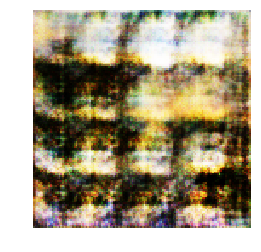

[33/500][80/99] Loss_D: 1.3792 Loss_G: 0.7426 D(x): 0.4908 D(G(z)): 0.4846 / 0.4760


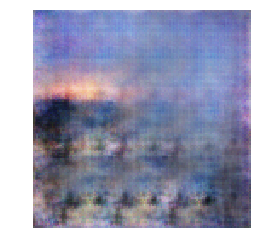

[33/500][90/99] Loss_D: 1.4133 Loss_G: 0.7381 D(x): 0.5201 D(G(z)): 0.5222 / 0.4789


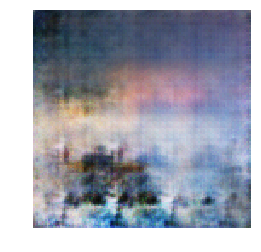

[34/500][0/99] Loss_D: 1.4051 Loss_G: 0.6872 D(x): 0.4974 D(G(z)): 0.5033 / 0.5052


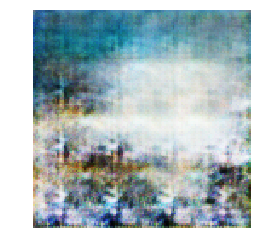

[34/500][10/99] Loss_D: 1.3970 Loss_G: 0.7259 D(x): 0.4816 D(G(z)): 0.4835 / 0.4858


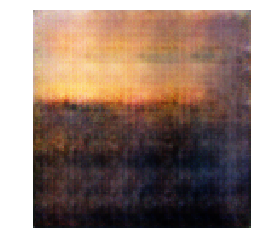

[34/500][20/99] Loss_D: 1.3949 Loss_G: 0.7671 D(x): 0.4633 D(G(z)): 0.4643 / 0.4647


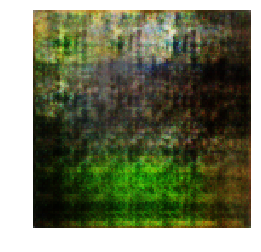

[34/500][30/99] Loss_D: 1.3816 Loss_G: 0.7314 D(x): 0.4828 D(G(z)): 0.4787 / 0.4816


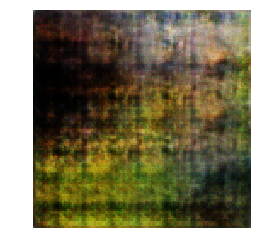

[34/500][40/99] Loss_D: 1.3939 Loss_G: 0.7157 D(x): 0.5046 D(G(z)): 0.5042 / 0.4892


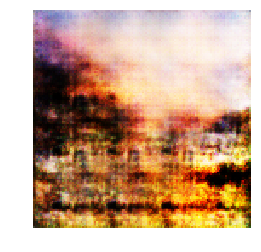

[34/500][50/99] Loss_D: 1.3988 Loss_G: 0.7441 D(x): 0.4819 D(G(z)): 0.4872 / 0.4753


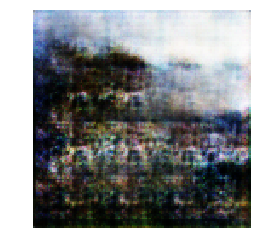

[34/500][60/99] Loss_D: 1.3928 Loss_G: 0.7567 D(x): 0.4799 D(G(z)): 0.4802 / 0.4703


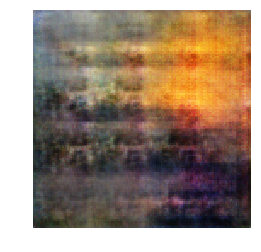

[34/500][70/99] Loss_D: 1.3801 Loss_G: 0.7557 D(x): 0.4843 D(G(z)): 0.4752 / 0.4706


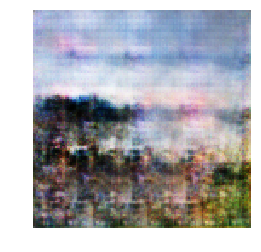

[34/500][80/99] Loss_D: 1.3729 Loss_G: 0.7265 D(x): 0.5037 D(G(z)): 0.4903 / 0.4848


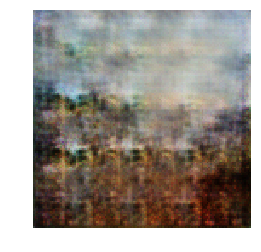

[34/500][90/99] Loss_D: 1.3901 Loss_G: 0.7238 D(x): 0.5015 D(G(z)): 0.4975 / 0.4860


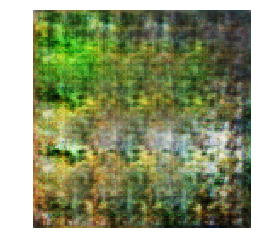

[35/500][0/99] Loss_D: 1.3745 Loss_G: 0.7193 D(x): 0.4923 D(G(z)): 0.4849 / 0.4874


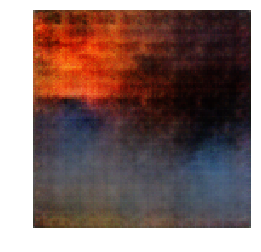

[35/500][10/99] Loss_D: 1.3785 Loss_G: 0.7282 D(x): 0.5287 D(G(z)): 0.5142 / 0.4831


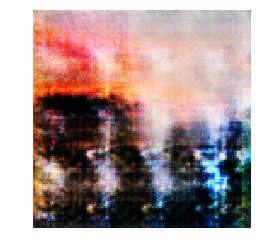

[35/500][20/99] Loss_D: 1.3800 Loss_G: 0.7068 D(x): 0.4970 D(G(z)): 0.4918 / 0.4940


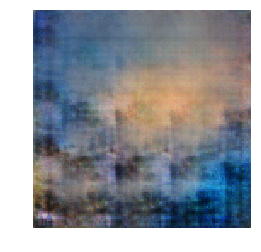

[35/500][30/99] Loss_D: 1.3907 Loss_G: 0.7343 D(x): 0.4851 D(G(z)): 0.4850 / 0.4803


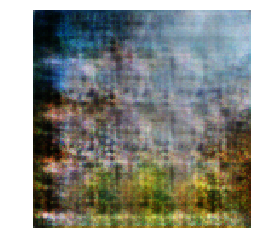

[35/500][40/99] Loss_D: 1.3870 Loss_G: 0.7390 D(x): 0.4761 D(G(z)): 0.4747 / 0.4777


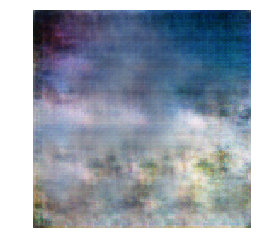

[35/500][50/99] Loss_D: 1.3701 Loss_G: 0.7238 D(x): 0.5000 D(G(z)): 0.4875 / 0.4862


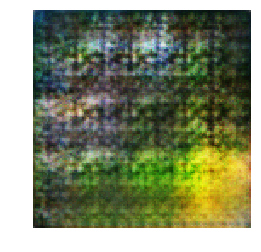

[35/500][60/99] Loss_D: 1.3894 Loss_G: 0.7659 D(x): 0.4674 D(G(z)): 0.4663 / 0.4651


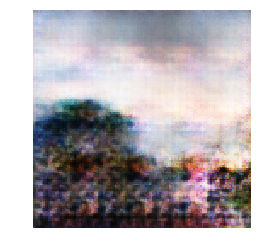

[35/500][70/99] Loss_D: 1.4145 Loss_G: 0.7669 D(x): 0.4755 D(G(z)): 0.4862 / 0.4649


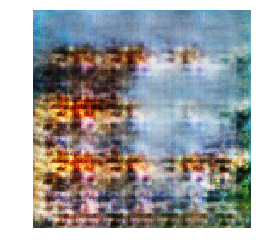

[35/500][80/99] Loss_D: 1.4047 Loss_G: 0.7656 D(x): 0.4643 D(G(z)): 0.4704 / 0.4655


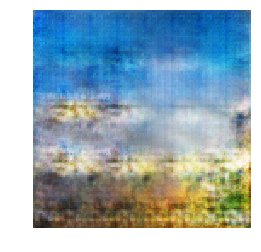

[35/500][90/99] Loss_D: 1.3822 Loss_G: 0.7418 D(x): 0.4891 D(G(z)): 0.4841 / 0.4767


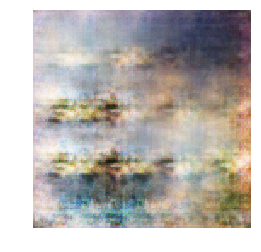

[36/500][0/99] Loss_D: 1.3665 Loss_G: 0.7356 D(x): 0.4884 D(G(z)): 0.4731 / 0.4806


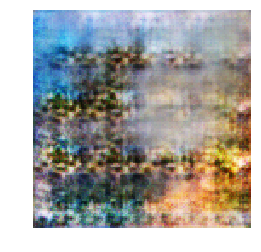

[36/500][10/99] Loss_D: 1.3957 Loss_G: 0.7281 D(x): 0.4846 D(G(z)): 0.4882 / 0.4830


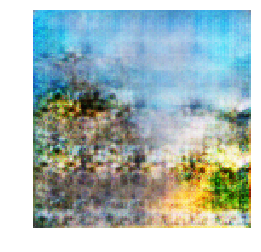

[36/500][20/99] Loss_D: 1.3753 Loss_G: 0.7364 D(x): 0.4853 D(G(z)): 0.4778 / 0.4794


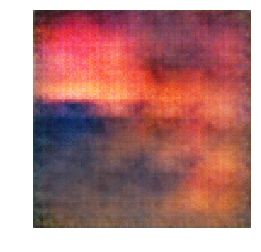

[36/500][30/99] Loss_D: 1.3858 Loss_G: 0.7139 D(x): 0.4905 D(G(z)): 0.4887 / 0.4901


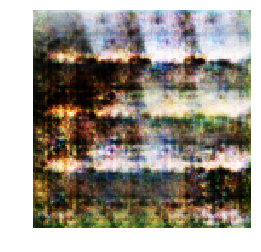

[36/500][40/99] Loss_D: 1.3882 Loss_G: 0.7292 D(x): 0.4964 D(G(z)): 0.4894 / 0.4830


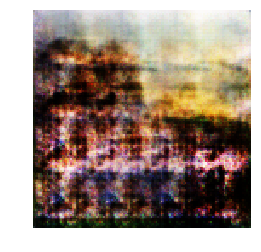

[36/500][50/99] Loss_D: 1.3947 Loss_G: 0.7194 D(x): 0.5410 D(G(z)): 0.5324 / 0.4874


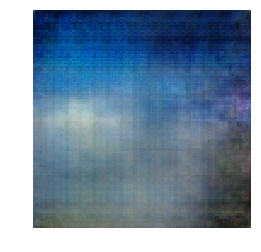

[36/500][60/99] Loss_D: 1.3639 Loss_G: 0.7281 D(x): 0.5073 D(G(z)): 0.4925 / 0.4835


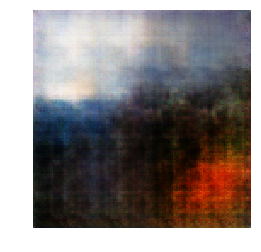

[36/500][70/99] Loss_D: 1.3446 Loss_G: 0.7209 D(x): 0.5255 D(G(z)): 0.4973 / 0.4873


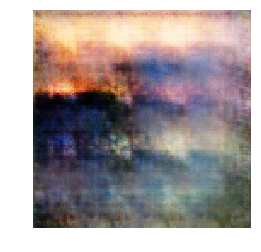

[36/500][80/99] Loss_D: 1.3848 Loss_G: 0.6783 D(x): 0.5586 D(G(z)): 0.5426 / 0.5087


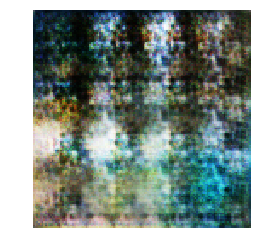

[36/500][90/99] Loss_D: 1.4026 Loss_G: 0.7463 D(x): 0.4862 D(G(z)): 0.4926 / 0.4743


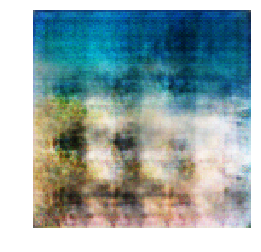

[37/500][0/99] Loss_D: 1.3924 Loss_G: 0.7184 D(x): 0.4959 D(G(z)): 0.4983 / 0.4878


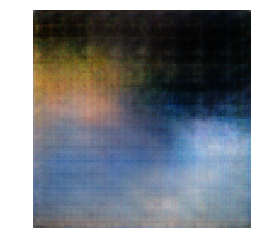

[37/500][10/99] Loss_D: 1.3899 Loss_G: 0.7269 D(x): 0.4888 D(G(z)): 0.4881 / 0.4840


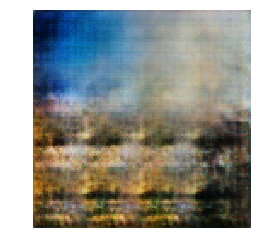

[37/500][20/99] Loss_D: 1.3791 Loss_G: 0.7362 D(x): 0.4887 D(G(z)): 0.4836 / 0.4791


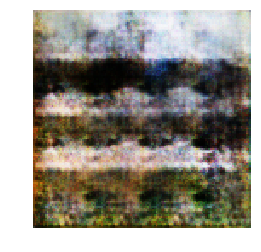

[37/500][30/99] Loss_D: 1.3898 Loss_G: 0.7331 D(x): 0.4826 D(G(z)): 0.4822 / 0.4812


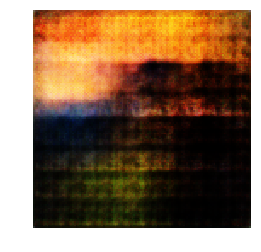

[37/500][40/99] Loss_D: 1.3896 Loss_G: 0.7640 D(x): 0.4672 D(G(z)): 0.4652 / 0.4670


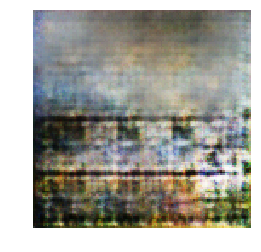

[37/500][50/99] Loss_D: 1.3811 Loss_G: 0.7541 D(x): 0.4760 D(G(z)): 0.4703 / 0.4707


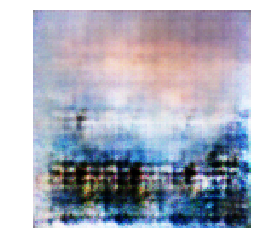

[37/500][60/99] Loss_D: 1.3317 Loss_G: 0.6493 D(x): 0.5204 D(G(z)): 0.4872 / 0.5267


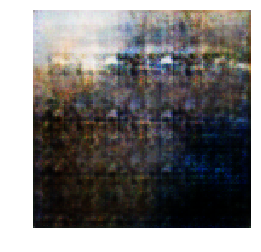

[37/500][70/99] Loss_D: 1.3919 Loss_G: 0.7544 D(x): 0.4746 D(G(z)): 0.4754 / 0.4704


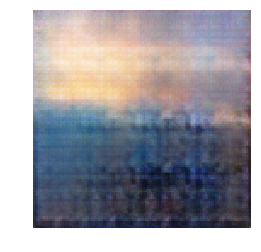

[37/500][80/99] Loss_D: 1.3654 Loss_G: 0.7380 D(x): 0.4942 D(G(z)): 0.4771 / 0.4798


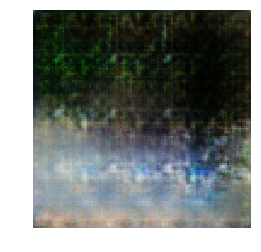

[37/500][90/99] Loss_D: 1.3713 Loss_G: 0.7395 D(x): 0.4873 D(G(z)): 0.4777 / 0.4779


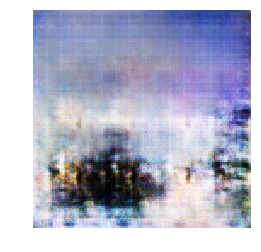

[38/500][0/99] Loss_D: 1.4330 Loss_G: 0.6764 D(x): 0.5097 D(G(z)): 0.5255 / 0.5100


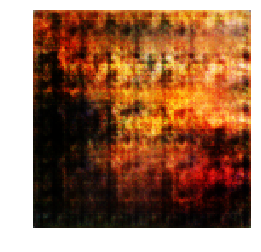

[38/500][10/99] Loss_D: 1.3878 Loss_G: 0.7722 D(x): 0.4677 D(G(z)): 0.4656 / 0.4622


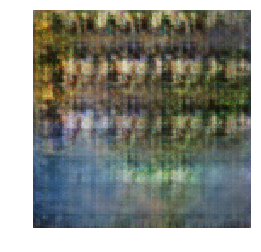

[38/500][20/99] Loss_D: 1.3911 Loss_G: 0.7433 D(x): 0.4750 D(G(z)): 0.4755 / 0.4759


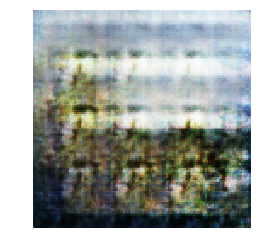

[38/500][30/99] Loss_D: 1.3331 Loss_G: 0.7042 D(x): 0.5151 D(G(z)): 0.4820 / 0.4959


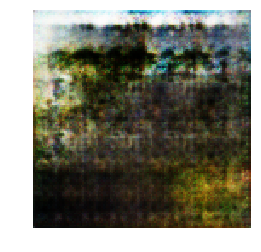

[38/500][40/99] Loss_D: 1.3831 Loss_G: 0.7381 D(x): 0.4824 D(G(z)): 0.4796 / 0.4782


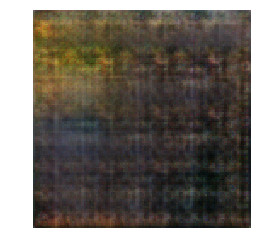

[38/500][50/99] Loss_D: 1.3463 Loss_G: 0.7380 D(x): 0.5317 D(G(z)): 0.5018 / 0.4788


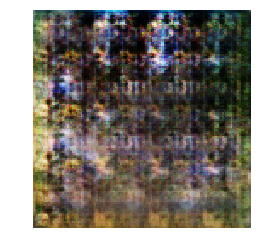

[38/500][60/99] Loss_D: 1.3919 Loss_G: 0.6763 D(x): 0.5074 D(G(z)): 0.5082 / 0.5093


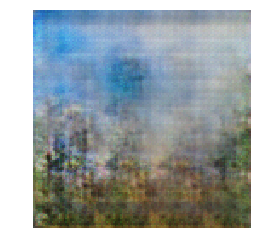

[38/500][70/99] Loss_D: 1.3926 Loss_G: 0.7431 D(x): 0.4977 D(G(z)): 0.4975 / 0.4761


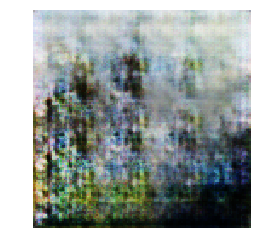

[38/500][80/99] Loss_D: 1.3821 Loss_G: 0.7282 D(x): 0.4834 D(G(z)): 0.4798 / 0.4834


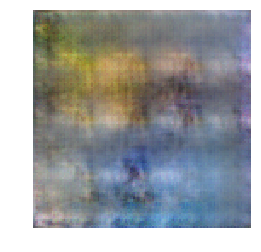

[38/500][90/99] Loss_D: 1.3964 Loss_G: 0.7281 D(x): 0.4886 D(G(z)): 0.4922 / 0.4831


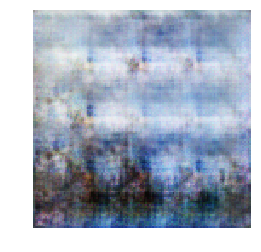

[39/500][0/99] Loss_D: 1.3843 Loss_G: 0.7286 D(x): 0.4852 D(G(z)): 0.4821 / 0.4828


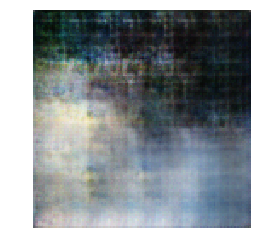

[39/500][10/99] Loss_D: 1.3758 Loss_G: 0.6716 D(x): 0.5268 D(G(z)): 0.5148 / 0.5121


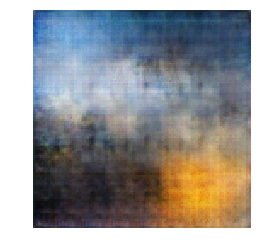

[39/500][20/99] Loss_D: 1.3820 Loss_G: 0.7430 D(x): 0.5041 D(G(z)): 0.4985 / 0.4761


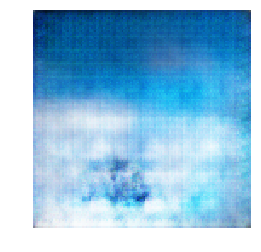

[39/500][30/99] Loss_D: 1.3809 Loss_G: 0.6559 D(x): 0.5563 D(G(z)): 0.5385 / 0.5201


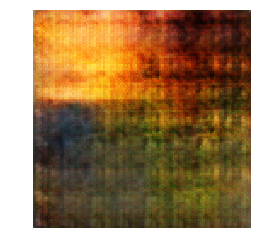

[39/500][40/99] Loss_D: 1.3848 Loss_G: 0.7228 D(x): 0.4798 D(G(z)): 0.4776 / 0.4861


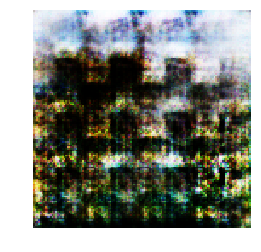

[39/500][50/99] Loss_D: 1.3964 Loss_G: 0.7108 D(x): 0.5058 D(G(z)): 0.5041 / 0.4924


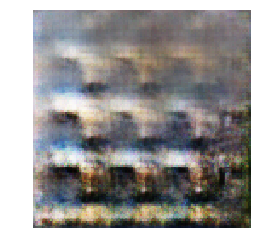

[39/500][60/99] Loss_D: 1.3896 Loss_G: 0.7582 D(x): 0.4721 D(G(z)): 0.4717 / 0.4687


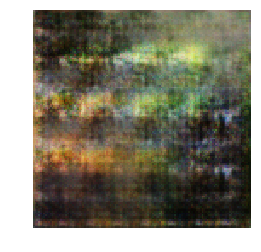

[39/500][70/99] Loss_D: 1.3882 Loss_G: 0.7290 D(x): 0.4876 D(G(z)): 0.4865 / 0.4829


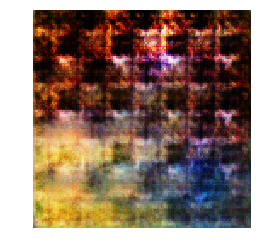

[39/500][80/99] Loss_D: 1.3928 Loss_G: 0.7046 D(x): 0.5074 D(G(z)): 0.5071 / 0.4952


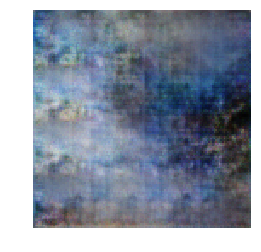

[39/500][90/99] Loss_D: 1.3691 Loss_G: 0.7288 D(x): 0.4895 D(G(z)): 0.4789 / 0.4834


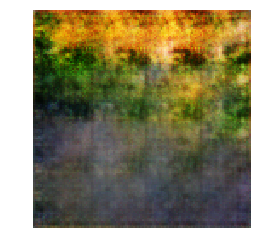

[40/500][0/99] Loss_D: 1.3828 Loss_G: 0.7251 D(x): 0.4868 D(G(z)): 0.4816 / 0.4859


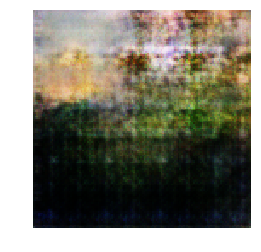

[40/500][10/99] Loss_D: 1.3763 Loss_G: 0.7075 D(x): 0.4996 D(G(z)): 0.4912 / 0.4942


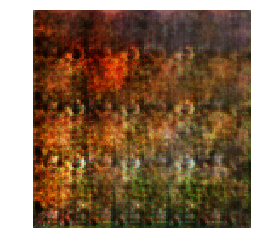

[40/500][20/99] Loss_D: 1.3916 Loss_G: 0.7200 D(x): 0.4901 D(G(z)): 0.4912 / 0.4870


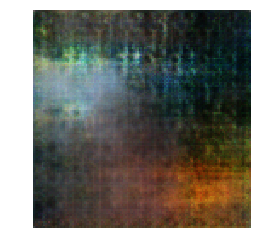

[40/500][30/99] Loss_D: 1.3832 Loss_G: 0.7270 D(x): 0.4791 D(G(z)): 0.4760 / 0.4840


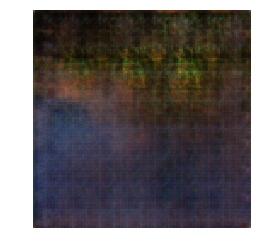

[40/500][40/99] Loss_D: 1.3492 Loss_G: 0.7014 D(x): 0.5297 D(G(z)): 0.5032 / 0.4976


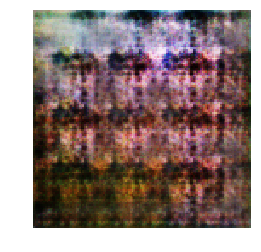

[40/500][50/99] Loss_D: 1.3803 Loss_G: 0.7283 D(x): 0.5017 D(G(z)): 0.4933 / 0.4840


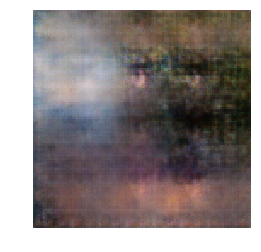

[40/500][60/99] Loss_D: 1.3915 Loss_G: 0.7504 D(x): 0.4732 D(G(z)): 0.4740 / 0.4724


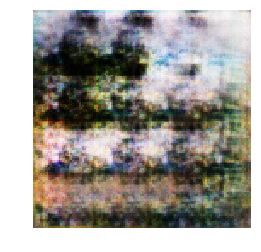

[40/500][70/99] Loss_D: 1.3953 Loss_G: 0.7308 D(x): 0.5052 D(G(z)): 0.5067 / 0.4819


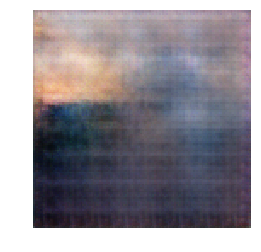

[40/500][80/99] Loss_D: 1.3434 Loss_G: 0.6432 D(x): 0.5261 D(G(z)): 0.4990 / 0.5281


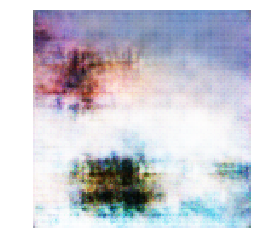

[40/500][90/99] Loss_D: 1.3891 Loss_G: 0.7472 D(x): 0.4733 D(G(z)): 0.4730 / 0.4738


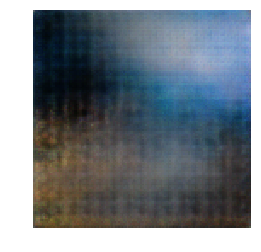

[41/500][0/99] Loss_D: 1.3812 Loss_G: 0.7310 D(x): 0.4842 D(G(z)): 0.4807 / 0.4815


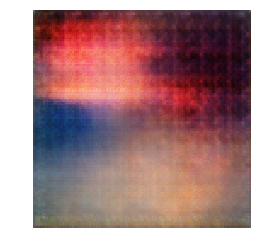

[41/500][10/99] Loss_D: 1.3843 Loss_G: 0.7254 D(x): 0.4866 D(G(z)): 0.4833 / 0.4847


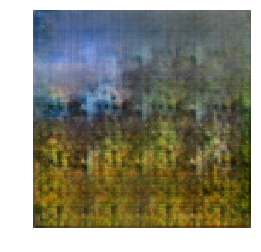

[41/500][20/99] Loss_D: 1.3954 Loss_G: 0.7367 D(x): 0.4786 D(G(z)): 0.4815 / 0.4790


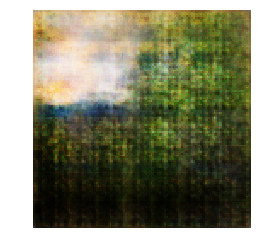

[41/500][30/99] Loss_D: 1.4125 Loss_G: 0.7283 D(x): 0.4971 D(G(z)): 0.5044 / 0.4834


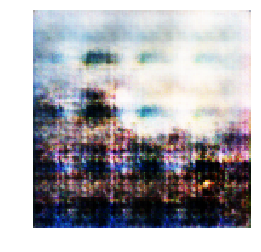

[41/500][40/99] Loss_D: 1.3794 Loss_G: 0.7319 D(x): 0.4864 D(G(z)): 0.4817 / 0.4814


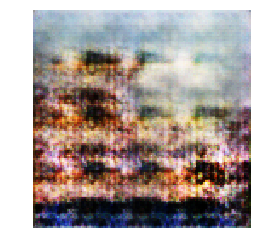

[41/500][50/99] Loss_D: 1.3995 Loss_G: 0.7065 D(x): 0.5070 D(G(z)): 0.5058 / 0.4952


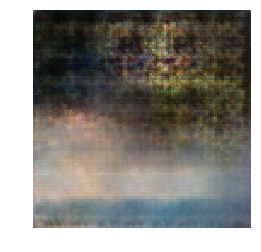

[41/500][60/99] Loss_D: 1.4049 Loss_G: 0.7125 D(x): 0.5174 D(G(z)): 0.5200 / 0.4909


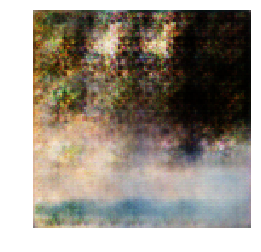

[41/500][70/99] Loss_D: 1.3943 Loss_G: 0.7381 D(x): 0.4785 D(G(z)): 0.4801 / 0.4784


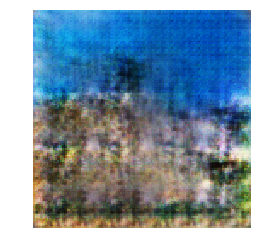

[41/500][80/99] Loss_D: 1.3954 Loss_G: 0.7235 D(x): 0.4853 D(G(z)): 0.4883 / 0.4854


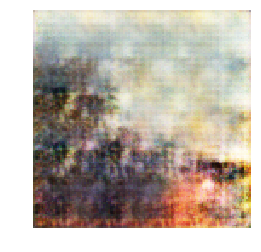

[41/500][90/99] Loss_D: 1.4004 Loss_G: 0.7117 D(x): 0.4907 D(G(z)): 0.4962 / 0.4910


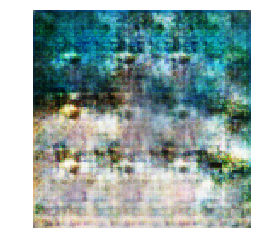

[42/500][0/99] Loss_D: 1.3833 Loss_G: 0.6652 D(x): 0.5230 D(G(z)): 0.5183 / 0.5147


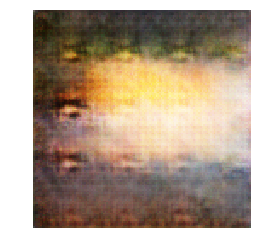

[42/500][10/99] Loss_D: 1.3932 Loss_G: 0.7243 D(x): 0.4851 D(G(z)): 0.4878 / 0.4847


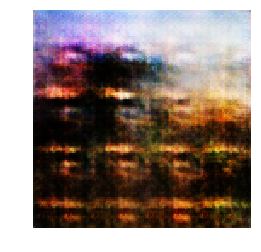

[42/500][20/99] Loss_D: 1.3772 Loss_G: 0.6808 D(x): 0.5274 D(G(z)): 0.5164 / 0.5079


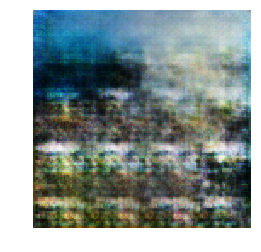

[42/500][30/99] Loss_D: 1.3585 Loss_G: 0.6807 D(x): 0.5096 D(G(z)): 0.4932 / 0.5075


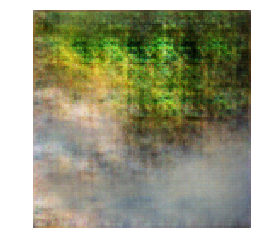

[42/500][40/99] Loss_D: 1.4493 Loss_G: 0.7395 D(x): 0.4919 D(G(z)): 0.5193 / 0.4775


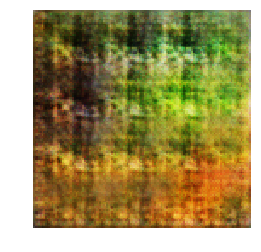

[42/500][50/99] Loss_D: 1.4001 Loss_G: 0.7235 D(x): 0.4976 D(G(z)): 0.5026 / 0.4854


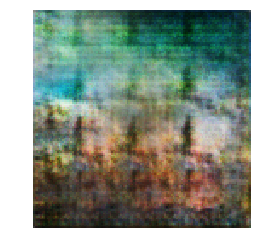

[42/500][60/99] Loss_D: 1.3931 Loss_G: 0.7474 D(x): 0.4799 D(G(z)): 0.4817 / 0.4737


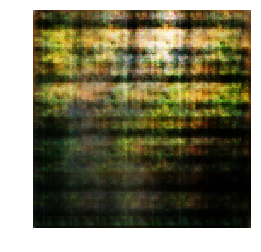

[42/500][70/99] Loss_D: 1.3982 Loss_G: 0.7165 D(x): 0.5071 D(G(z)): 0.5104 / 0.4887


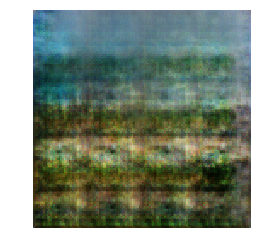

[42/500][80/99] Loss_D: 1.3915 Loss_G: 0.7186 D(x): 0.4836 D(G(z)): 0.4853 / 0.4875


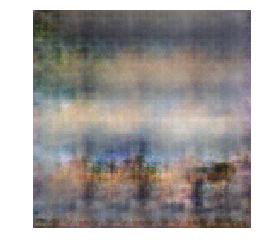

[42/500][90/99] Loss_D: 1.3944 Loss_G: 0.7204 D(x): 0.4867 D(G(z)): 0.4902 / 0.4867


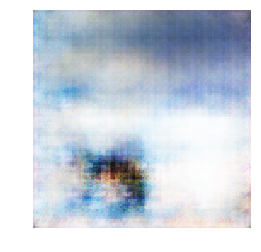

[43/500][0/99] Loss_D: 1.3988 Loss_G: 0.7128 D(x): 0.4958 D(G(z)): 0.5003 / 0.4907


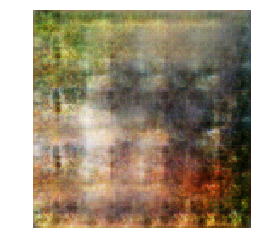

[43/500][10/99] Loss_D: 1.3892 Loss_G: 0.7147 D(x): 0.4930 D(G(z)): 0.4933 / 0.4896


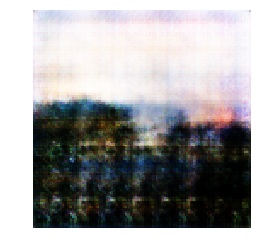

[43/500][20/99] Loss_D: 1.4031 Loss_G: 0.7253 D(x): 0.5045 D(G(z)): 0.5092 / 0.4843


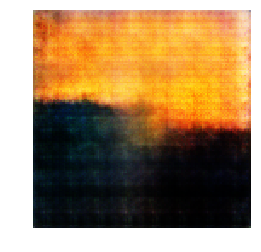

[43/500][30/99] Loss_D: 1.3924 Loss_G: 0.6754 D(x): 0.5158 D(G(z)): 0.5153 / 0.5096


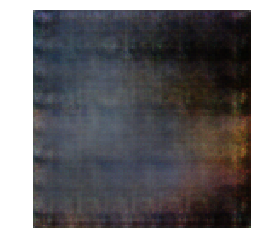

[43/500][40/99] Loss_D: 1.3849 Loss_G: 0.7487 D(x): 0.4777 D(G(z)): 0.4756 / 0.4731


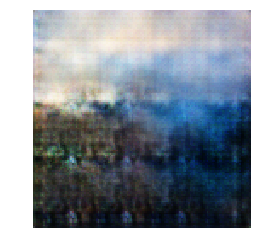

[43/500][50/99] Loss_D: 1.3840 Loss_G: 0.7233 D(x): 0.4863 D(G(z)): 0.4838 / 0.4854


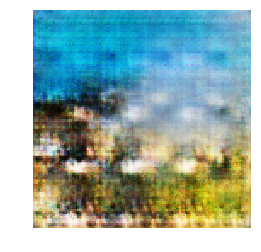

[43/500][60/99] Loss_D: 1.3669 Loss_G: 0.6904 D(x): 0.5302 D(G(z)): 0.5098 / 0.5039


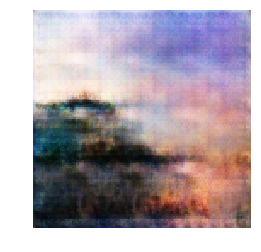

[43/500][70/99] Loss_D: 1.3662 Loss_G: 0.7350 D(x): 0.5042 D(G(z)): 0.4877 / 0.4813


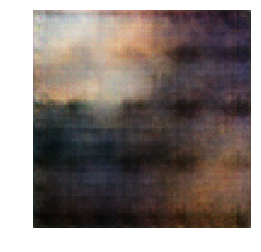

[43/500][80/99] Loss_D: 1.3823 Loss_G: 0.7430 D(x): 0.4769 D(G(z)): 0.4734 / 0.4758


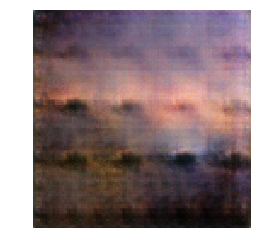

[43/500][90/99] Loss_D: 1.3675 Loss_G: 0.6816 D(x): 0.5093 D(G(z)): 0.4972 / 0.5071


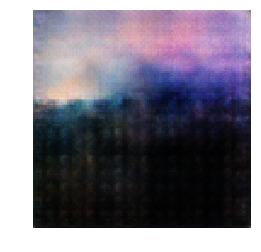

[44/500][0/99] Loss_D: 1.3825 Loss_G: 0.7094 D(x): 0.5038 D(G(z)): 0.4957 / 0.4932


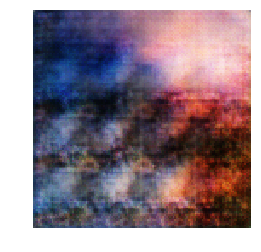

[44/500][10/99] Loss_D: 1.3758 Loss_G: 0.7228 D(x): 0.4870 D(G(z)): 0.4798 / 0.4862


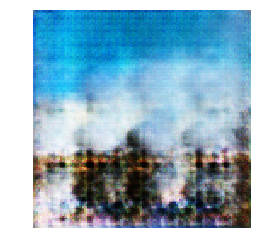

[44/500][20/99] Loss_D: 1.3879 Loss_G: 0.7146 D(x): 0.4890 D(G(z)): 0.4890 / 0.4897


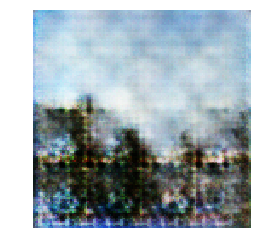

[44/500][30/99] Loss_D: 1.3958 Loss_G: 0.7200 D(x): 0.4871 D(G(z)): 0.4910 / 0.4870


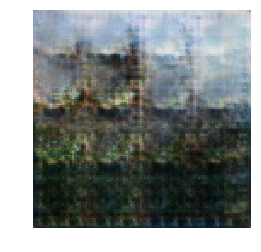

[44/500][40/99] Loss_D: 1.3751 Loss_G: 0.7010 D(x): 0.5307 D(G(z)): 0.5164 / 0.4967


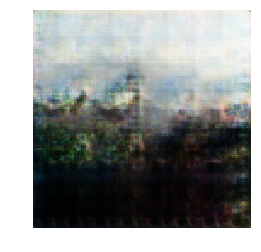

[44/500][50/99] Loss_D: 1.3961 Loss_G: 0.7115 D(x): 0.4879 D(G(z)): 0.4917 / 0.4912


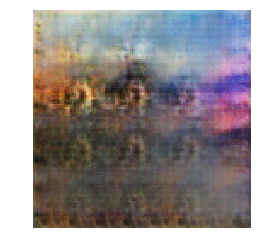

[44/500][60/99] Loss_D: 1.3896 Loss_G: 0.7105 D(x): 0.5017 D(G(z)): 0.4999 / 0.4919


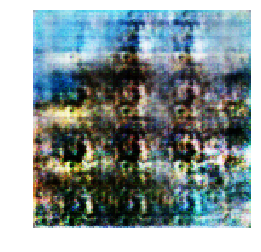

[44/500][70/99] Loss_D: 1.3903 Loss_G: 0.6863 D(x): 0.5076 D(G(z)): 0.5081 / 0.5037


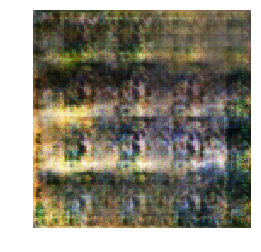

[44/500][80/99] Loss_D: 1.3671 Loss_G: 0.7395 D(x): 0.4987 D(G(z)): 0.4871 / 0.4780


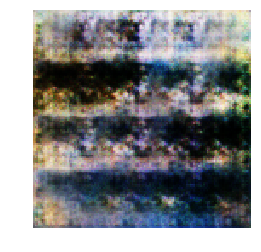

[44/500][90/99] Loss_D: 1.3597 Loss_G: 0.6848 D(x): 0.5052 D(G(z)): 0.4877 / 0.5059


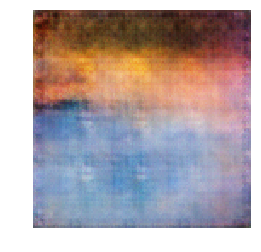

[45/500][0/99] Loss_D: 1.3843 Loss_G: 0.7338 D(x): 0.4841 D(G(z)): 0.4808 / 0.4804


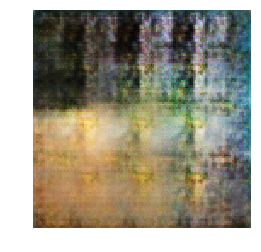

[45/500][10/99] Loss_D: 1.3866 Loss_G: 0.7364 D(x): 0.4802 D(G(z)): 0.4786 / 0.4792


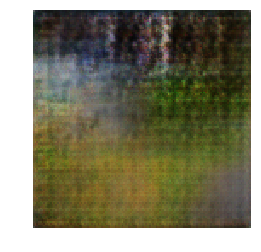

[45/500][20/99] Loss_D: 1.3853 Loss_G: 0.7508 D(x): 0.4769 D(G(z)): 0.4749 / 0.4721


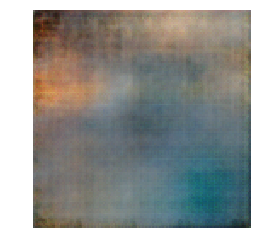

[45/500][30/99] Loss_D: 1.3945 Loss_G: 0.7330 D(x): 0.4837 D(G(z)): 0.4857 / 0.4809


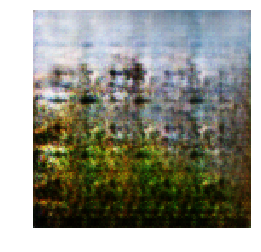

[45/500][40/99] Loss_D: 1.3787 Loss_G: 0.7406 D(x): 0.4833 D(G(z)): 0.4774 / 0.4774


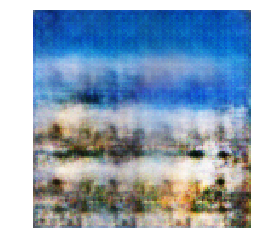

[45/500][50/99] Loss_D: 1.3535 Loss_G: 0.6869 D(x): 0.5284 D(G(z)): 0.5033 / 0.5049


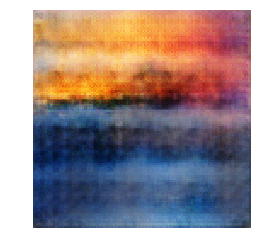

[45/500][60/99] Loss_D: 1.3915 Loss_G: 0.7456 D(x): 0.4732 D(G(z)): 0.4741 / 0.4746


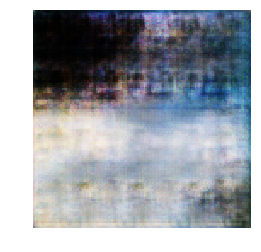

[45/500][70/99] Loss_D: 1.3921 Loss_G: 0.7673 D(x): 0.4702 D(G(z)): 0.4710 / 0.4644


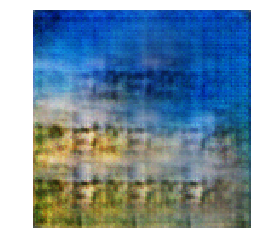

[45/500][80/99] Loss_D: 1.3962 Loss_G: 0.6755 D(x): 0.5448 D(G(z)): 0.5366 / 0.5106


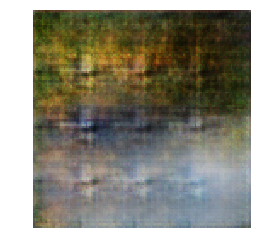

[45/500][90/99] Loss_D: 1.3925 Loss_G: 0.7358 D(x): 0.4873 D(G(z)): 0.4886 / 0.4793


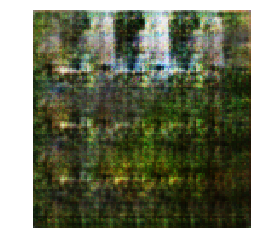

[46/500][0/99] Loss_D: 1.3913 Loss_G: 0.6979 D(x): 0.4993 D(G(z)): 0.4999 / 0.4981


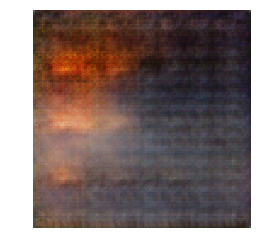

[46/500][10/99] Loss_D: 1.3819 Loss_G: 0.7366 D(x): 0.4842 D(G(z)): 0.4812 / 0.4788


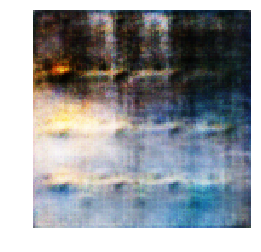

[46/500][20/99] Loss_D: 1.4202 Loss_G: 0.6773 D(x): 0.5181 D(G(z)): 0.5282 / 0.5088


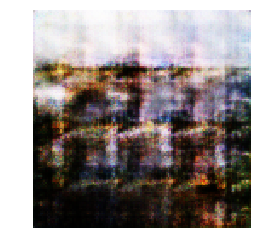

[46/500][30/99] Loss_D: 1.3849 Loss_G: 0.6974 D(x): 0.5001 D(G(z)): 0.4975 / 0.4983


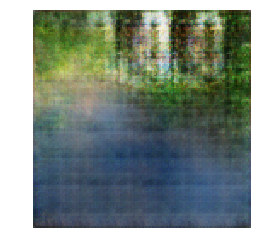

[46/500][40/99] Loss_D: 1.3790 Loss_G: 0.7048 D(x): 0.5083 D(G(z)): 0.5009 / 0.4951


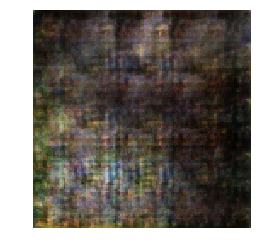

[46/500][50/99] Loss_D: 1.3949 Loss_G: 0.7179 D(x): 0.4938 D(G(z)): 0.4973 / 0.4878


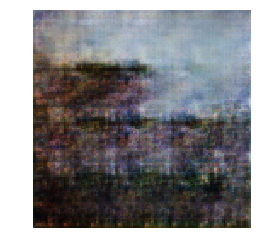

[46/500][60/99] Loss_D: 1.3892 Loss_G: 0.7518 D(x): 0.4737 D(G(z)): 0.4728 / 0.4717


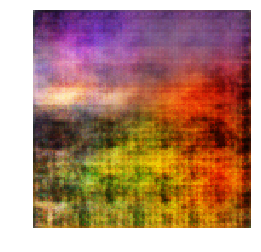

[46/500][70/99] Loss_D: 1.3821 Loss_G: 0.7620 D(x): 0.4813 D(G(z)): 0.4761 / 0.4676


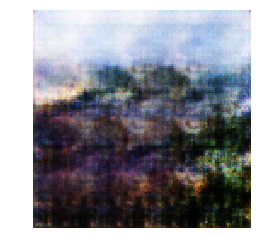

[46/500][80/99] Loss_D: 1.3446 Loss_G: 0.7121 D(x): 0.5021 D(G(z)): 0.4769 / 0.4916


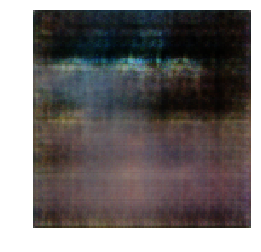

[46/500][90/99] Loss_D: 1.3793 Loss_G: 0.7123 D(x): 0.4879 D(G(z)): 0.4827 / 0.4910


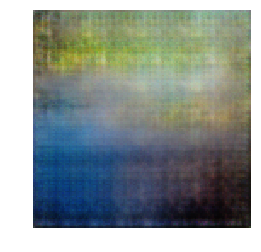

[47/500][0/99] Loss_D: 1.3887 Loss_G: 0.7454 D(x): 0.4740 D(G(z)): 0.4731 / 0.4749


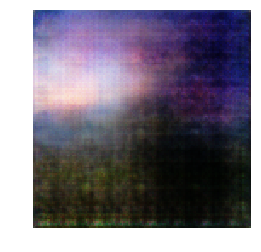

[47/500][10/99] Loss_D: 1.4066 Loss_G: 0.7250 D(x): 0.5069 D(G(z)): 0.5129 / 0.4850


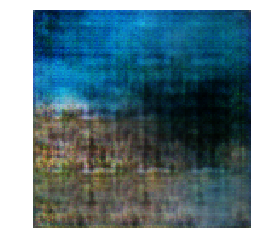

[47/500][20/99] Loss_D: 1.3623 Loss_G: 0.6749 D(x): 0.5340 D(G(z)): 0.5118 / 0.5113


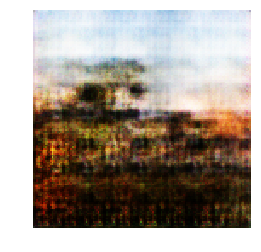

[47/500][30/99] Loss_D: 1.4051 Loss_G: 0.7390 D(x): 0.4775 D(G(z)): 0.4853 / 0.4777


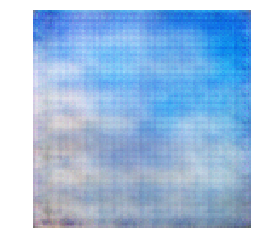

[47/500][40/99] Loss_D: 1.3595 Loss_G: 0.7000 D(x): 0.5361 D(G(z)): 0.5154 / 0.4969


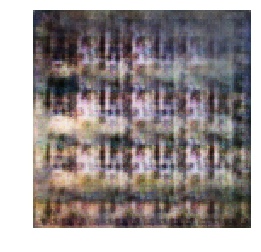

[47/500][50/99] Loss_D: 1.4292 Loss_G: 0.7161 D(x): 0.4996 D(G(z)): 0.5190 / 0.4888


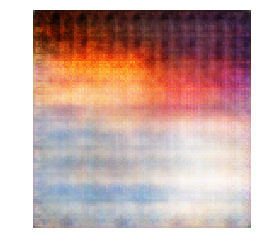

[47/500][60/99] Loss_D: 1.3519 Loss_G: 0.7183 D(x): 0.5021 D(G(z)): 0.4815 / 0.4890


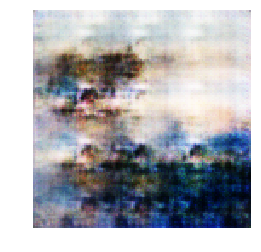

[47/500][70/99] Loss_D: 1.3941 Loss_G: 0.7299 D(x): 0.4789 D(G(z)): 0.4810 / 0.4821


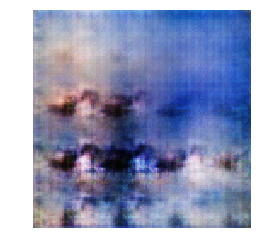

[47/500][80/99] Loss_D: 1.3852 Loss_G: 0.7349 D(x): 0.4829 D(G(z)): 0.4801 / 0.4803


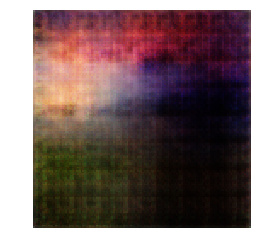

[47/500][90/99] Loss_D: 1.3297 Loss_G: 0.6715 D(x): 0.5498 D(G(z)): 0.5133 / 0.5121


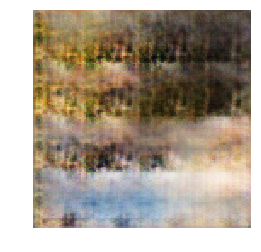

[48/500][0/99] Loss_D: 1.4017 Loss_G: 0.7323 D(x): 0.4774 D(G(z)): 0.4835 / 0.4810


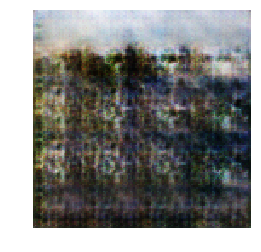

[48/500][10/99] Loss_D: 1.3576 Loss_G: 0.7096 D(x): 0.5164 D(G(z)): 0.4975 / 0.4929


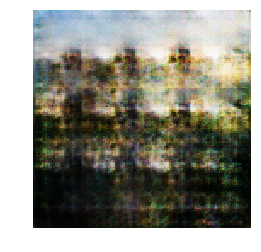

[48/500][20/99] Loss_D: 1.3867 Loss_G: 0.7214 D(x): 0.4849 D(G(z)): 0.4843 / 0.4861


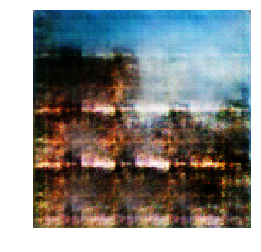

[48/500][30/99] Loss_D: 1.3843 Loss_G: 0.7193 D(x): 0.4992 D(G(z)): 0.4950 / 0.4878


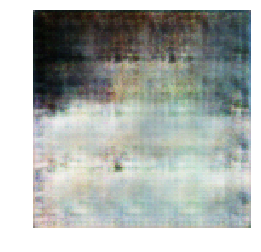

[48/500][40/99] Loss_D: 1.3500 Loss_G: 0.7078 D(x): 0.5060 D(G(z)): 0.4850 / 0.4937


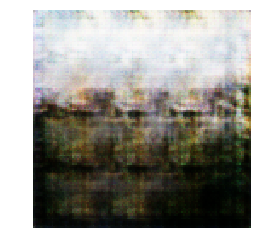

[48/500][50/99] Loss_D: 1.3763 Loss_G: 0.7483 D(x): 0.4791 D(G(z)): 0.4724 / 0.4734


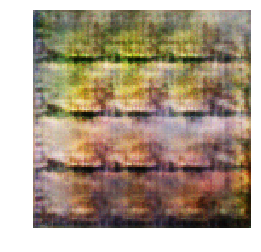

[48/500][60/99] Loss_D: 1.3864 Loss_G: 0.7286 D(x): 0.4854 D(G(z)): 0.4846 / 0.4828


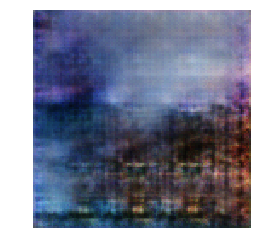

[48/500][70/99] Loss_D: 1.4143 Loss_G: 0.7174 D(x): 0.5157 D(G(z)): 0.5216 / 0.4884


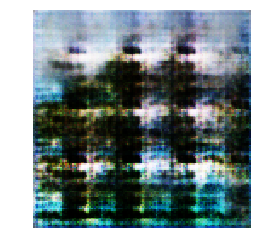

[48/500][80/99] Loss_D: 1.3775 Loss_G: 0.6940 D(x): 0.4989 D(G(z)): 0.4928 / 0.5005


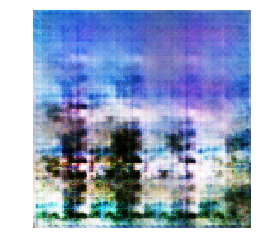

[48/500][90/99] Loss_D: 1.3441 Loss_G: 0.6933 D(x): 0.5567 D(G(z)): 0.5226 / 0.5008


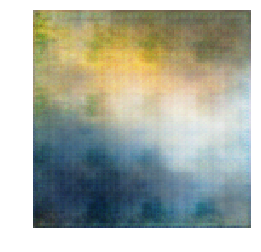

[49/500][0/99] Loss_D: 1.3818 Loss_G: 0.6924 D(x): 0.5151 D(G(z)): 0.5078 / 0.5014


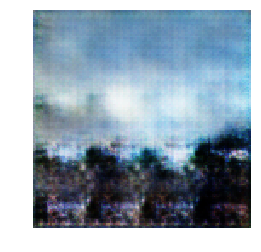

[49/500][10/99] Loss_D: 1.3879 Loss_G: 0.7383 D(x): 0.4807 D(G(z)): 0.4806 / 0.4780


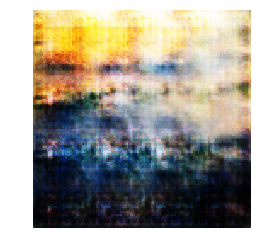

[49/500][20/99] Loss_D: 1.4473 Loss_G: 0.7073 D(x): 0.4972 D(G(z)): 0.5223 / 0.4938


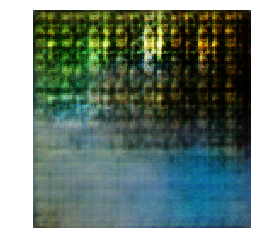

[49/500][30/99] Loss_D: 1.3790 Loss_G: 0.7282 D(x): 0.4905 D(G(z)): 0.4848 / 0.4834


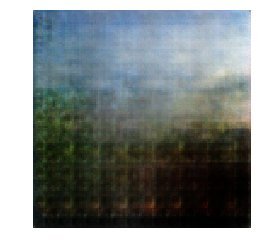

[49/500][40/99] Loss_D: 1.3852 Loss_G: 0.7170 D(x): 0.4894 D(G(z)): 0.4883 / 0.4883


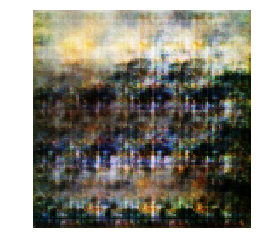

[49/500][50/99] Loss_D: 1.3692 Loss_G: 0.7393 D(x): 0.4892 D(G(z)): 0.4788 / 0.4776


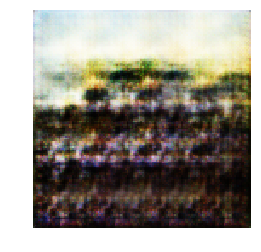

[49/500][60/99] Loss_D: 1.3806 Loss_G: 0.7432 D(x): 0.4861 D(G(z)): 0.4815 / 0.4760


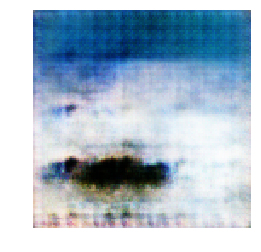

[49/500][70/99] Loss_D: 1.3486 Loss_G: 0.6951 D(x): 0.5280 D(G(z)): 0.5019 / 0.4997


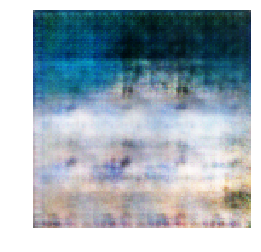

[49/500][80/99] Loss_D: 1.3954 Loss_G: 0.7371 D(x): 0.4860 D(G(z)): 0.4895 / 0.4787


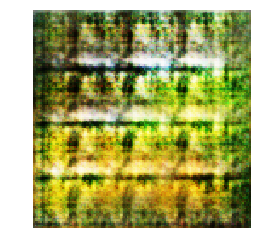

[49/500][90/99] Loss_D: 1.3828 Loss_G: 0.7326 D(x): 0.4894 D(G(z)): 0.4855 / 0.4812


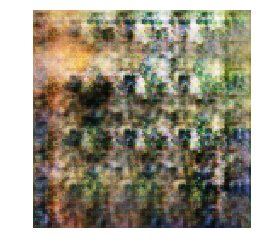

[50/500][0/99] Loss_D: 1.4399 Loss_G: 0.7032 D(x): 0.4974 D(G(z)): 0.5204 / 0.4953


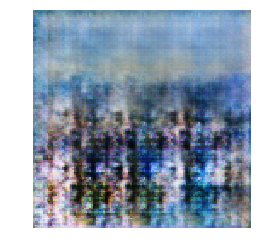

[50/500][10/99] Loss_D: 1.4093 Loss_G: 0.7093 D(x): 0.4929 D(G(z)): 0.5033 / 0.4922


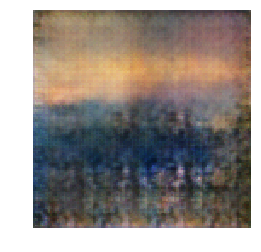

[50/500][20/99] Loss_D: 1.3859 Loss_G: 0.7000 D(x): 0.4932 D(G(z)): 0.4925 / 0.4968


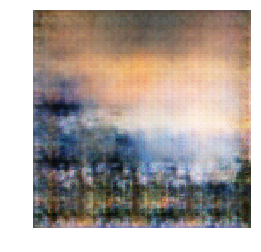

[50/500][30/99] Loss_D: 1.3746 Loss_G: 0.7225 D(x): 0.5024 D(G(z)): 0.4937 / 0.4857


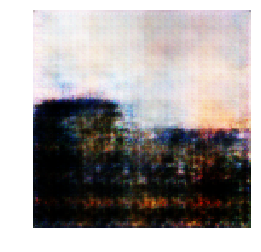

[50/500][40/99] Loss_D: 1.3837 Loss_G: 0.7107 D(x): 0.4938 D(G(z)): 0.4921 / 0.4914


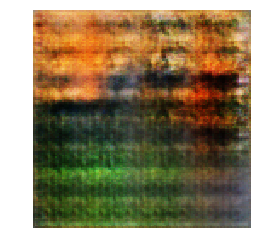

[50/500][50/99] Loss_D: 1.4250 Loss_G: 0.6999 D(x): 0.5304 D(G(z)): 0.5408 / 0.4968


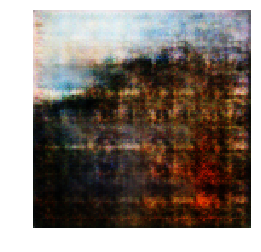

[50/500][60/99] Loss_D: 1.3985 Loss_G: 0.7225 D(x): 0.4841 D(G(z)): 0.4891 / 0.4857


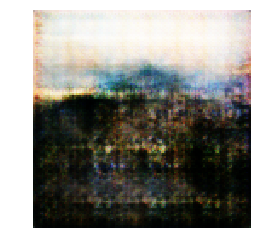

[50/500][70/99] Loss_D: 1.3925 Loss_G: 0.7201 D(x): 0.5311 D(G(z)): 0.5254 / 0.4868


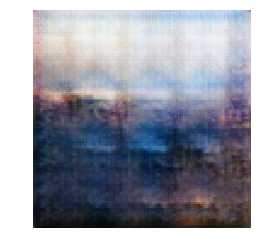

[50/500][80/99] Loss_D: 1.3833 Loss_G: 0.7333 D(x): 0.4822 D(G(z)): 0.4797 / 0.4805


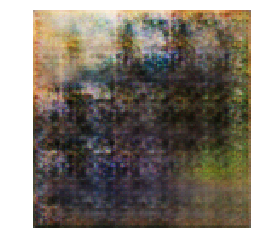

[50/500][90/99] Loss_D: 1.4107 Loss_G: 0.7391 D(x): 0.4888 D(G(z)): 0.4999 / 0.4776


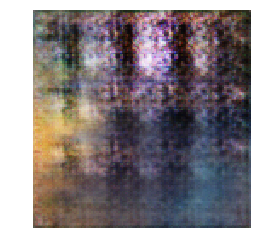

[51/500][0/99] Loss_D: 1.4177 Loss_G: 0.7496 D(x): 0.4896 D(G(z)): 0.5024 / 0.4727


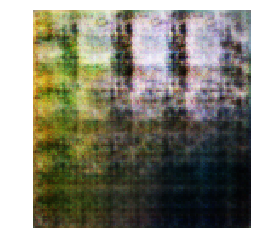

[51/500][10/99] Loss_D: 1.3660 Loss_G: 0.6975 D(x): 0.5029 D(G(z)): 0.4897 / 0.4991


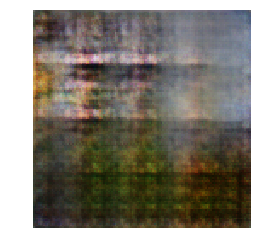

[51/500][20/99] Loss_D: 1.3779 Loss_G: 0.6927 D(x): 0.5162 D(G(z)): 0.5088 / 0.5010


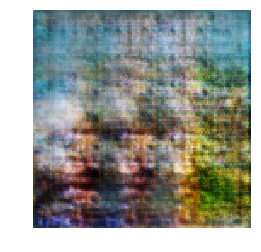

[51/500][30/99] Loss_D: 1.3994 Loss_G: 0.7270 D(x): 0.4819 D(G(z)): 0.4874 / 0.4835


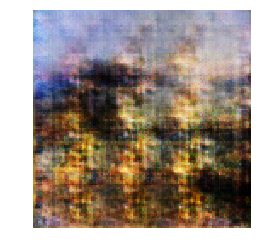

[51/500][40/99] Loss_D: 1.3831 Loss_G: 0.7531 D(x): 0.4735 D(G(z)): 0.4698 / 0.4711


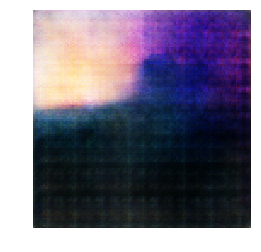

[51/500][50/99] Loss_D: 1.3804 Loss_G: 0.7447 D(x): 0.4789 D(G(z)): 0.4745 / 0.4750


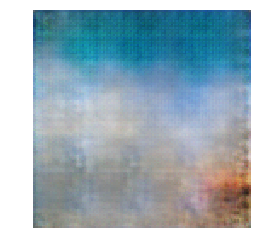

[51/500][60/99] Loss_D: 1.3913 Loss_G: 0.7375 D(x): 0.4800 D(G(z)): 0.4805 / 0.4789


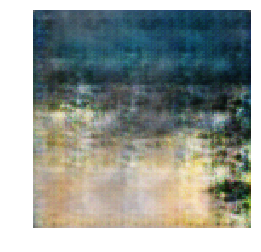

[51/500][70/99] Loss_D: 1.3869 Loss_G: 0.7321 D(x): 0.4845 D(G(z)): 0.4833 / 0.4812


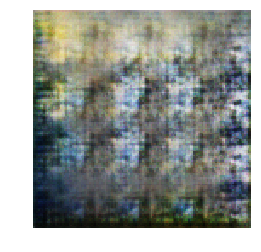

[51/500][80/99] Loss_D: 1.3869 Loss_G: 0.7256 D(x): 0.4861 D(G(z)): 0.4858 / 0.4841


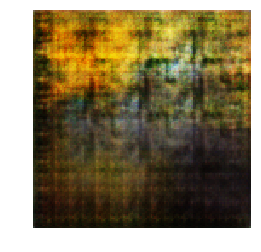

[51/500][90/99] Loss_D: 1.3665 Loss_G: 0.7128 D(x): 0.4974 D(G(z)): 0.4863 / 0.4906


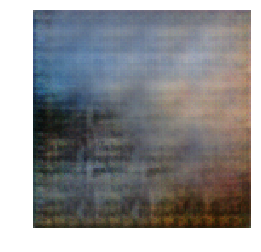

[52/500][0/99] Loss_D: 1.3824 Loss_G: 0.7212 D(x): 0.4925 D(G(z)): 0.4895 / 0.4866


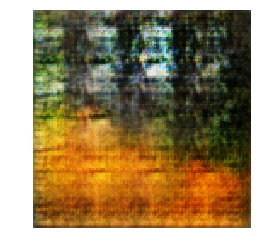

[52/500][10/99] Loss_D: 1.3952 Loss_G: 0.7052 D(x): 0.4913 D(G(z)): 0.4953 / 0.4941


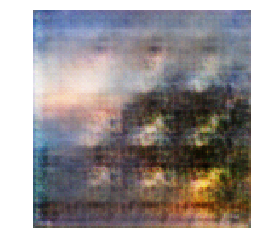

[52/500][20/99] Loss_D: 1.3766 Loss_G: 0.7049 D(x): 0.5010 D(G(z)): 0.4957 / 0.4942


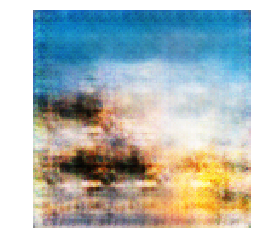

[52/500][30/99] Loss_D: 1.4124 Loss_G: 0.7527 D(x): 0.4809 D(G(z)): 0.4929 / 0.4712


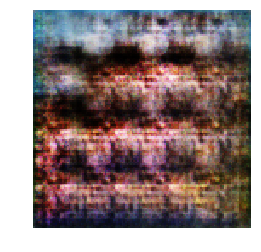

[52/500][40/99] Loss_D: 1.4133 Loss_G: 0.7714 D(x): 0.4862 D(G(z)): 0.4956 / 0.4629


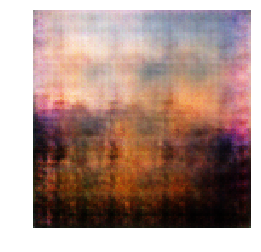

[52/500][50/99] Loss_D: 1.3898 Loss_G: 0.6915 D(x): 0.5249 D(G(z)): 0.5196 / 0.5020


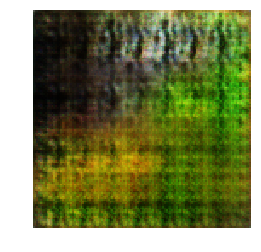

[52/500][60/99] Loss_D: 1.3868 Loss_G: 0.7147 D(x): 0.4915 D(G(z)): 0.4907 / 0.4896


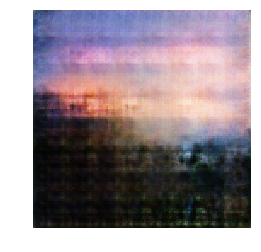

[52/500][70/99] Loss_D: 1.3908 Loss_G: 0.7184 D(x): 0.4874 D(G(z)): 0.4892 / 0.4876


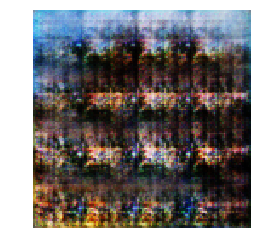

[52/500][80/99] Loss_D: 1.3978 Loss_G: 0.6954 D(x): 0.5094 D(G(z)): 0.5086 / 0.4996


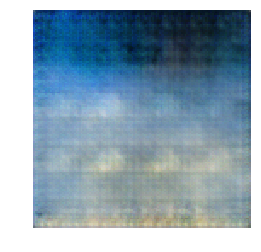

[52/500][90/99] Loss_D: 1.3906 Loss_G: 0.7047 D(x): 0.4924 D(G(z)): 0.4939 / 0.4943


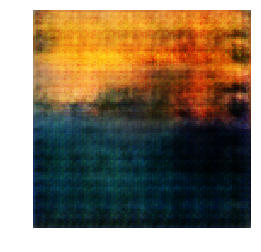

[53/500][0/99] Loss_D: 1.3850 Loss_G: 0.7370 D(x): 0.4814 D(G(z)): 0.4798 / 0.4786


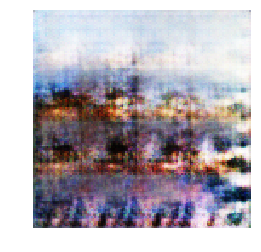

[53/500][10/99] Loss_D: 1.3805 Loss_G: 0.7289 D(x): 0.4870 D(G(z)): 0.4834 / 0.4825


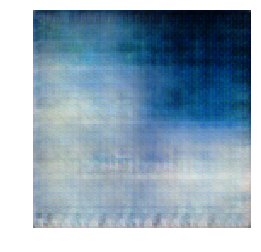

[53/500][20/99] Loss_D: 1.3829 Loss_G: 0.7077 D(x): 0.4920 D(G(z)): 0.4899 / 0.4930


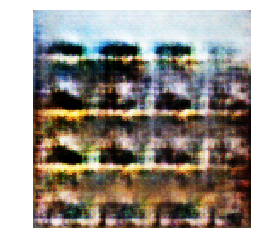

[53/500][30/99] Loss_D: 1.3722 Loss_G: 0.6886 D(x): 0.4972 D(G(z)): 0.4891 / 0.5028


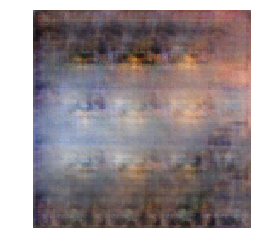

[53/500][40/99] Loss_D: 1.3741 Loss_G: 0.7318 D(x): 0.4871 D(G(z)): 0.4800 / 0.4812


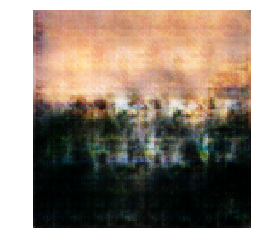

[53/500][50/99] Loss_D: 1.4079 Loss_G: 0.7254 D(x): 0.4769 D(G(z)): 0.4864 / 0.4842


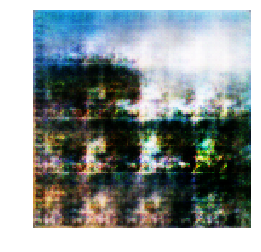

[53/500][60/99] Loss_D: 1.3774 Loss_G: 0.7139 D(x): 0.4965 D(G(z)): 0.4913 / 0.4899


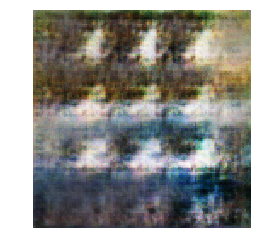

[53/500][70/99] Loss_D: 1.4237 Loss_G: 0.7234 D(x): 0.4954 D(G(z)): 0.5105 / 0.4858


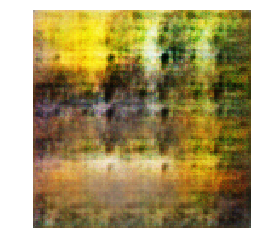

[53/500][80/99] Loss_D: 1.3815 Loss_G: 0.7279 D(x): 0.4988 D(G(z)): 0.4946 / 0.4833


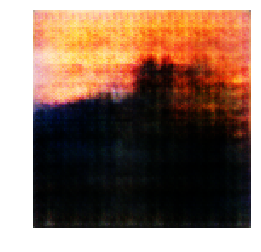

[53/500][90/99] Loss_D: 1.3807 Loss_G: 0.7128 D(x): 0.4950 D(G(z)): 0.4912 / 0.4907


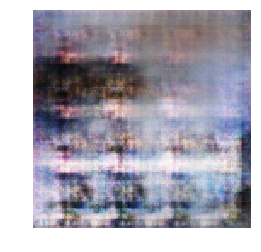

[54/500][0/99] Loss_D: 1.3656 Loss_G: 0.7156 D(x): 0.4966 D(G(z)): 0.4836 / 0.4902


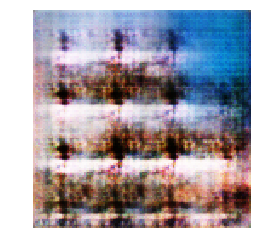

[54/500][10/99] Loss_D: 1.3967 Loss_G: 0.7235 D(x): 0.4814 D(G(z)): 0.4857 / 0.4851


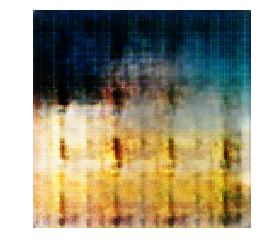

[54/500][20/99] Loss_D: 1.3825 Loss_G: 0.7089 D(x): 0.5030 D(G(z)): 0.4994 / 0.4925


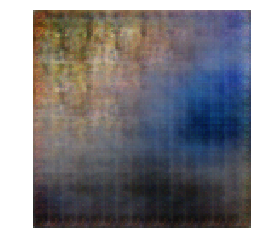

In [ ]:
# real_label = np.random.uniform(0.7, 1.1)
# fake_label = np.random.uniform(0.0, 0.3)

real_label = 1
fake_label = 0

for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):
        

        
        data = np.array(data)

        
        
        #### Training Discriminator Network ####

        # train with real training data

        netD.zero_grad()

        real_img = Variable(torch.FloatTensor(data))


        if GPU: 
            real_img = real_img.cuda()

        minibatch_size = real_img.shape[0]

        
        real_lbl = Variable(torch.FloatTensor(np.ones(minibatch_size,)*real_label))
       
        if GPU: 
            real_lbl = real_lbl.cuda()
        
        output = netD(real_img)
        
        errD_real = criterion(output, real_lbl)
        D_x = output.mean().data
        


        # train with generated data
        
        noise = Variable(torch.randn(minibatch_size, 100, 1, 1))
        fake_lbl = Variable(torch.FloatTensor(np.ones(minibatch_size,)*fake_label))
        
        if GPU: 
            noise = noise.cuda()
            fake_lbl = fake_lbl.cuda()
            
        fake = netG(noise)
        

        output = netD(fake.detach())
        errD_fake = criterion(output, fake_lbl)
         
        D_G_z1 = output.mean().data

        
        errD = errD_real + errD_fake

        errD.backward() ################################################### BACKPROP HERE
        optimizerD.step()

        
        
        #### Training Generator Network ####
        
        netG.zero_grad()
        
        noise = Variable(torch.randn(minibatch_size, 100, 1, 1))
        
        if GPU: 
            noise = noise.cuda()
        
        fake = netG(noise)
        output = netD(fake)
        errG = criterion(output, real_lbl)
        
        errG.backward() ################################################### BACKPROP HERE

        D_G_z2 = output.mean().data
        optimizerG.step()
        
        


        if i % 10 == 0:ss
            
            print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.data, errG.data, D_x, D_G_z1, D_G_z2))
            
            fake = netG(noise)
            disp_img = np.moveaxis(fake.data.cpu().numpy()[0], 0, 2)
            
#             print(disp_img.shape)
            
            plt.imshow((disp_img + 1) / 2)
            plt.axis('off')
            plt.show()
            
#             vutils.save_image(fake.data.cpu().numpy()[0],
#                               '%s/fake_samples_epoch_%d_%d.png' % (output_dir, epoch, i),
#                               normalize=True)

            # do checkpointing
    torch.save(netG.state_dict(), '%s/netG_epoch_%d.pth' % (output_dir, epoch))
    torch.save(netD.state_dict(), '%s/netD_epoch_%d.pth' % (output_dir, epoch))

        

        




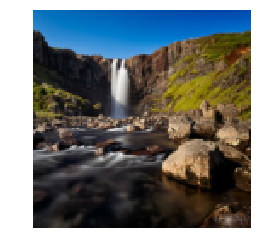

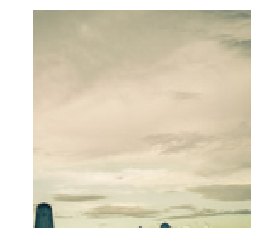

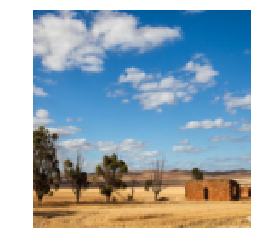

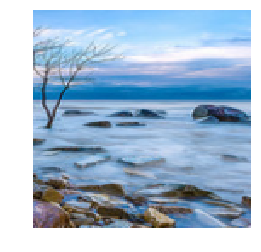

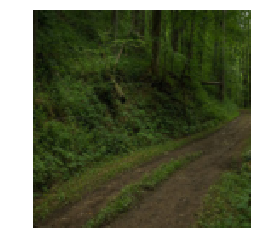

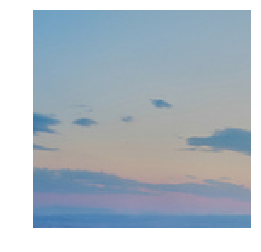

In [31]:
for i, data in enumerate(train_loader, 0):
    data = np.array(data)
    
    plt.figure()
    to_plot = np.moveaxis(data[i, :, :, :], 0, 2)
    plt.imshow(to_plot)
    plt.axis('off')

#     imshow_batch(data)
    
    if i == 5:
        break